# Project Ventoux, part 1: applying machine learning techniques to Beatport and Spotify data

For the last few months (March 2024 to now), I've been teaching myself python. As part of this process, I've been spending a lot of time with a Beatport and Spotify data set[Beatport and Spotify music data set](https://www.kaggle.com/datasets/mcfurland/10-m-beatport-tracks-spotify-audio-features) I found on Kaggle's dataset repository. In addition, I've supplmented with other data from around the web. 

For part 1, I'm using a dataset I made that marries together Beatport chart rankingsa with Spotify and Beatport track data. Overall, I have Beatport track data for around ten million songs. When I filter for just the top songs overall and by genre (ranging from 500 to 1,300)tracks, depending on genre), it drops down to around 95,000.

For more detailed information on why I chose this project and how I approached it, please [read this project overview](https://www.uwsthoughts.com/linear-logistic-regression/) on my website. 

Questions? HMU at hello@uwsthoughts.com

## Some common ways I import and use data
Depends on where I am and what I have going on, I use any one of these to import and organize data. In a separate workflow, I keep files between the three sources synced.

### These always get called, regardless of underlying data source

In [3]:
#I know best practice is to use tian for pandas but I chose the name of a famous DC zoo panda instead. 
import pandas as tian #named after a DC zoo panda
tian.set_option('display.max_columns', None) #invoking pandas setting I always prefer

#I also diverged from numpy as lumpnump because thismakes me laugh and still tells me it's numpy
import numpy as lumpnump
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn import metrics
from sklearn.metrics import root_mean_squared_error, mean_absolute_error, r2_score
from sklearn.model_selection import train_test_split
import copy
from scipy.stats import norm
import math
import os


### These are run when I use my Google Cloud Platform instance

In [4]:
#in case there are issues with using env variables
# !pip install certifi
# import os
# import certifi

# os.environ['SSL_CERT_FILE'] = certifi.where()

#for using gcp
# from google.cloud import storage as gcs
# from google.oauth2 import service_account as gsa
# from io import BytesIO
# import gcsfs
# from dotenv import load_dotenv

# load_dotenv()

# # System variables
# google_client_id = os.getenv('GOOGLE_CLIENT_ID')
# google_client_secret = os.getenv('GOOGLE_CLIENT_SECRET')
# google_project_id = os.getenv('GOOGLE_MUSIC_PROJECT')
# google_bucket = os.getenv('GOOGLE_PRIMARY_BUCKET')
# os.environ['GOOGLE_APPLICATION_CREDENTIALS'] = os.getenv('GOOGLE_SERVICE_CREDENTIALS')

# # GCS setup details
# bucket_file_base = f"gs://{google_bucket}/"
# gcp_storage = gcs.Client()
# gcp_primary_bucket = gcp_storage.bucket(google_bucket)
# gcp_file_system = gcsfs.GCSFileSystem()

# gcp file example
# fact_bp_track_audio_audio_features_csv = f"gs://{google_bucket}/fact_bp_track_audio_features.csv"

### Importing files from my local computer
I've obfuscated most of the file path. The file names in the Notebook match file names in the Github repository.

In [5]:
top_tracks_stem = os.getenv('TOP_TRACKS_STEM')

toptracks_bpmeta_matrix_csv = f'{top_tracks_stem}/toptracks_bpmeta_matrix'
toptracks_bpmeta_matrix_df_csv = f'{top_tracks_stem}/toptracks_bpmeta_matrix_df'

toptracks_bpmeta_matrix_df = tian.read_csv(toptracks_bpmeta_matrix_df_csv)
toptracks_bpmeta_matrix = lumpnump.genfromtxt(toptracks_bpmeta_matrix_csv, delimiter=',')

### for the music heads - the most controversial decision I made in the data prep phase
I had to do a lot of work around cleaning up "mix" because the values were inconsistent. This is prep work for a future phase and I didn't do anything with it here.

In [6]:
mix_name_changes = [
    ("Continuous DJ Mix", "Mixed"),
    ("Mix Cut", "Set Mixed"),
    ("Mixed", "Set Mixed"),
    ("Intro Mix", "Set Mixed"),
    ("Edit", "Radio Edit"),
    ("Main Mix", "Original Mix"),
    ("Album Version", "Album Mix"),
    ("Deep Mix", "Remix"),
    ("House Mix", "Remix"),
    ("Tribal Mix", "Remix"),
    ("Intro", "Set Mixed"),
    ("Edit Mix", "Radio Mix"),
    ("Bonus Track", "Album Mix"),
    ("continuous", "Set Mixed"),
    ("live", "Set Mixed"),
    ("remastered", "Remastered Mix"),
    ("orginal", "Original Mix"),
    ("ambient", "Ambient Mix"),
    ("chill", "Ambient Mix"),
    ("lounge", "Ambient Mix"),
    ("rework", "Remastered Mix"),
    ("remix", "Remix"),
    ("original", "Original Mix"),
    ("club", "Club Mix"),
    ("dub", "Dub Mix"),
    ("extended", "Extended Mix"),
    ("instrumental", "Instrumental Mix"),
    ("radio", "Radio Mix"),
    ("vip", "Remix"),
    ("album", "Album Mix"),
]

# for current_mix_value, utianated_mix_value in mix_name_changes:
#     fact_bpmeta_audio_df['mix'] = fact_bpmeta_audio_df['mix'].apply(lambda x: utianated_mix_value if isinstance(x, str) and current_mix_value.lower() in x.lower() else x)


## Defining cost, gradient, and gradient descent functions

### Cost function

In [7]:
def single_var_cost_function(x, y, w, b, lambdar):
    sample_size_m = x.shape[0]
    cost = 0.
    for i in range(sample_size_m):
        f_wb_i = lumpnump.dot(x[i], w) + b                                   
        cost += (f_wb_i - y[i])**2                                       
    cost = cost / (2 * sample_size_m)                                           
 
    regularized_cost = 0
    for j in range(len(w)):
        regularized_cost += (w[j]**2)                                   
    regularized_cost = (lambdar / (2 * sample_size_m)) * regularized_cost                   
    single_var_total_cost = cost + regularized_cost
    
    return single_var_total_cost


### Gradient function

In [8]:
def single_var_compute_gradient(x, y, w, b, lambdar):
    sample_size_m, n = x.shape
    single_var_djdw = lumpnump.zeros((n,))
    single_var_djdb = 0.
    for i in range(sample_size_m):
        cost_error = (lumpnump.dot(x[i], w) + b) - y[i]
        for j in range(n):                         
            single_var_djdw[j] += cost_error * x[i, j]
        single_var_djdb += cost_error
    single_var_djdw = single_var_djdw / sample_size_m
    single_var_djdb = single_var_djdb / sample_size_m
    for j in range(n):
        single_var_djdw[j] = single_var_djdw[j] + (lambdar / sample_size_m) * w[j]
        
    return single_var_djdw, single_var_djdb



### Gradient descent

In [9]:
def single_var_gradient_descent(x, y, initial_w, initial_b, single_var_cost_function, single_var_compute_gradient, learning_rate, iterations, lambdar): 
    sample_size_m = x.shape[0]
    j_history = []
    w_history = []
    w = copy.deepcopy(initial_w) 
    b = initial_b
    
    for iteration in range(iterations):
        single_var_djdw, single_var_djdb = single_var_compute_gradient(x, y, w, b, lambdar)  
        w = w - learning_rate * single_var_djdw               
        b = b - learning_rate * single_var_djdb               
        if iteration < 100000:  
            single_var_cost = single_var_cost_function(x, y, w, b, lambdar)
            j_history.append(single_var_cost)
            w_history.append(w)
        # if iteration % math.ceil(iterations / 10) == 0:
        #     print(f"Iteration {iteration:4}: Cost {float(j_history[-1]):8.2f}")
    
    return w, b, j_history, w_history



## Normalization functions

### z-score normalization + graping function
I didn't change these z-score functions too much after I plucked them out of some deeplearning.ai workbooks I had. I wanted to use them the way I had been taught but, in the moment, didn't remember excactly how to code it.

In [10]:
def zscore_normalize(x):
    feature_mean = lumpnump.mean(x, axis=0)
    standard_deviation = lumpnump.std(x, axis=0)
    x_normalized = (x - feature_mean) / standard_deviation
    return x_normalized, feature_mean, standard_deviation

def norm_plot(ax, data):
    scale = (lumpnump.max(data) - lumpnump.min(data)) * 0.2
    x = lumpnump.linspace(lumpnump.min(data) - scale, lumpnump.max(data) + scale, 50)
    _, bins, _ = ax.hist(data, bins=50, color="xkcd:azure", alpha=0.7)

    mu = lumpnump.mean(data)
    std = lumpnump.std(data)
    dist = norm.pdf(bins, loc=mu, scale=std)

    axr = ax.twinx()
    axr.plot(bins, dist, color="orangered", lw=2)
    axr.set_ylim(bottom=0)
    axr.axis('off')

### mean normalization + graphing function

In [11]:
def mean_normalization(x):
    feature_mean = lumpnump.mean(x, axis=0)
    feature_max = lumpnump.max(x)
    feature_min = lumpnump.min(x)
    x_mean_normalized = (x - feature_mean) / (feature_max - feature_min)
    return x_mean_normalized

#plots before and after in one swing
def mean_plot(data, title):
    normalized_data = mean_normalization(data)
    mean_values = lumpnump.mean(data, axis=0)

    plt.figure(figsize=(9, 4))

    # Before normalization
    plt.subplot(1, 2, 1)
    plt.plot(data)
    plt.plot([], [], label='Original Data') 
    if lumpnump.ndim(mean_values) == 0:
        plt.axhline(y=mean_values, color='b', linestyle='--', label='Mean')
    else:
        for value in mean_values:
            plt.axhline(y=value, color='b', linestyle='--', label='Mean')
    plt.title(f'Before: {title}')
    plt.legend()
    
    # After normalization
    plt.subplot(1, 2, 2)
    plt.plot(normalized_data, color='green')
    plt.plot([], [], label='Normalized Data', color='green')
    plt.axhline(y=0, color='b', linestyle='--', label='Mean Normalized')
    plt.title(f'After: {title}')
    plt.legend()
    
    plt.tight_layout()
    plt.show()

### Log normalization function + graphing

In [12]:
def log_normalization(x):
    x_log = lumpnump.log(x + 1)
    return x_log

def log_plot(data, title):
    log_data = log_normalization(data)
    mean_values = lumpnump.mean(data)
    
    plt.figure(figsize=(9, 4))

    # Before normalization
    plt.subplot(1, 2, 1)
    plt.plot(data, label='Original Data')
    if lumpnump.ndim(mean_values) == 0:
        plt.axhline(y=mean_values, color='b', linestyle='--', label='Mean')
    else:
        for value in mean_values:
            plt.axhline(y=value, color='b', linestyle='--', label='Mean')
    plt.title(f'Before: {title}')
    plt.legend()
    plt.xlabel('Index')
    plt.ylabel('Value')
    
    # After normalization
    plt.subplot(1, 2, 2)
    plt.plot(log_data, color='green', label='Log Normalized')
    log_mean = lumpnump.mean(log_data)
    if lumpnump.ndim(log_mean) == 0:
        plt.axhline(y=log_mean, color='b', linestyle='--', label='Log Normalized Mean')
    else:
        for value in log_mean:
            plt.axhline(y=value, color='b', linestyle='--', label='Log Normalized Mean')
    plt.title(f'After: {title}')
    plt.legend()
    plt.xlabel('Index')
    plt.ylabel('Log Value')
    
    plt.tight_layout()
    plt.show()

    

## Preparing data for regression

### defining train/validate/split function

In [13]:
def training_split(data, train_size, validate_size, test_size):
    lumpnump.random.shuffle(data)
    x_train, x_temp = train_test_split(data, test_size=(validate_size + test_size), random_state=42)
    x_validate, x_test = train_test_split(x_temp, test_size=test_size/(validate_size + test_size), random_state=42)
    
    return x_train, x_validate, x_test
    

### Creating dictionary that maps field names to matrix indexes so it's easier to keep track of

In [14]:
toptracks_bpmeta_matrix_df_columns = toptracks_bpmeta_matrix_df.columns

toptracks_bpmeta_matrix_df_dict = {name: idx for idx, name in enumerate(toptracks_bpmeta_matrix_df_columns)}
toptracks_bpmeta_matrix_df_dict

{'isrc_numeric': 0,
 'release_id': 1,
 'release_date': 2,
 'release_year': 3,
 'release_month': 4,
 'label_id': 5,
 'track_id': 6,
 'genre_id_x': 7,
 'mix_id': 8,
 'is_remixed': 9,
 'duration': 10,
 'duration_ms': 11,
 'bpm': 12,
 'key_id': 13,
 'time_signature': 14,
 'mode': 15,
 'valence': 16,
 'danceability': 17,
 'energy': 18,
 'speechiness': 19,
 'loudness': 20,
 'liveness': 21,
 'instrumentalness': 22,
 'acousticness': 23,
 'year': 24,
 'genre_id_y': 25,
 'rank': 26,
 'beatport_track_id': 27,
 'points': 28}

### Establishing a subset of genres and labels to focus on
The labels and genres chosen were picked because they represent pretty different styles of music and should have different characteristics. Will they actually? We will soon find out. 

There are only around 35 total Beatport genres so expanding out to cover all of them for the next piece of work would be easy enough. However, there are over 78,000 labels in the beatport data and....I'm not graphing all 78,000. I picked 4 labels that effectively showcase all three genres. I have beef with melodic house and melodic techno being one genre so I picked Afterlife to cover melodic techno and Anjunadeep to cover melodic house.

#### The label ID/name mappings were messy

I checked on the Beatport website and determined:
* The only Afterlife one that actually belongs to the famous melodic techno label is 56958. The others appear random and unrelated.
* all day I dream in waves doesn't appear related to All Day I Dream, the famous daytime party label
* Anjunadeep only has one ID, 1390. ID 804, Anjunabeats, is their sister trance label. Doesn't look like 42679, Anjuna Records, is related.

![Label IDs Work](https://i.imgur.com/ewlGBXB.png)

#### maping out the genre and label IDs I want to their names 
This will make it easier to keep track of later

In [15]:
subset_genres = [6, 90, 93]
subset_genres_dict = {
    6: "Techno (Peak Time/Driving)",
    90: "Melodic House & Techno",
    93: "Organic House / Downtempo"
}

subset_labels = [1390, 23038, 2027, 56958]


label_ids_dict = {
    1390:'Ajunadeep',
    23038: 'All Day I Dream',
    2027: 'Drumcode',
    56958: 'Afterlife Records'
}

#core is just I know these IDs should remain stable and can be used with the label IDs as well
core_x_features = [16, 17, 18, 19, 20, 21, 22, 23]
core_y_target = 28


### Creating train, validate, and test data sets 
I want to do work with all three types of nornmalization so I'm creating three copies of the dataset to make things easier to track.

In [16]:
#creating copies of matrix for each type of normalization
zscore_toptracks_matrix = toptracks_bpmeta_matrix
mean_normalized_toptracks_matrix = toptracks_bpmeta_matrix
log_nornmalized_toptracks_matrix = toptracks_bpmeta_matrix

#initial ratios to try
train_ratio = 0.6
validate_ratio = 0.2
test_ratio = 0.2

zscore_train, zscore_validate, zscore_test = training_split(zscore_toptracks_matrix, train_ratio, validate_ratio, test_ratio)
mean_train, mean_validate, mean_test = training_split(mean_normalized_toptracks_matrix, train_ratio, validate_ratio, test_ratio)
log_train, log_validate, log_test = training_split(log_nornmalized_toptracks_matrix, train_ratio, validate_ratio, test_ratio)


## Scatter plots of selected genres and labels for different metrics against points
The feature_ids are based on the dictionary I created above. In the loop is a piece that grabs the human-readable names from the dictionary. 

#### By Genre
Based on the outputs, in future work I'll need to figure out a better approach for things like "speechiness" where there's intense clustering at one end. I have a suspicion, purely as a music friend, that there's been a lot of movement overtime within the narrow clusters. 

Genre: Techno (Peak Time/Driving)
x_features shape: (4857, 8)
y_points shape: (4857, 1)


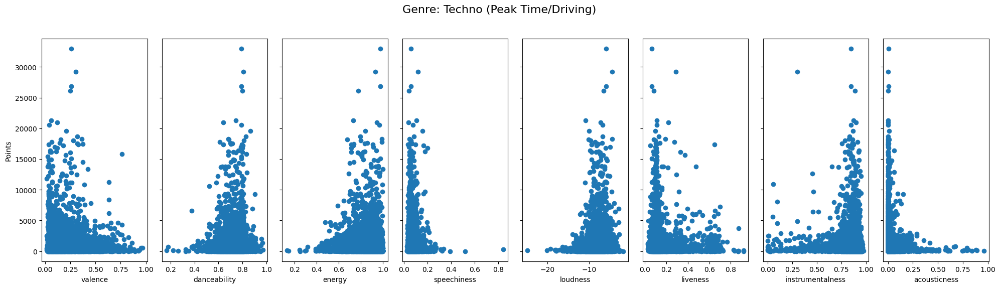

Genre: Melodic House & Techno
x_features shape: (4075, 8)
y_points shape: (4075, 1)


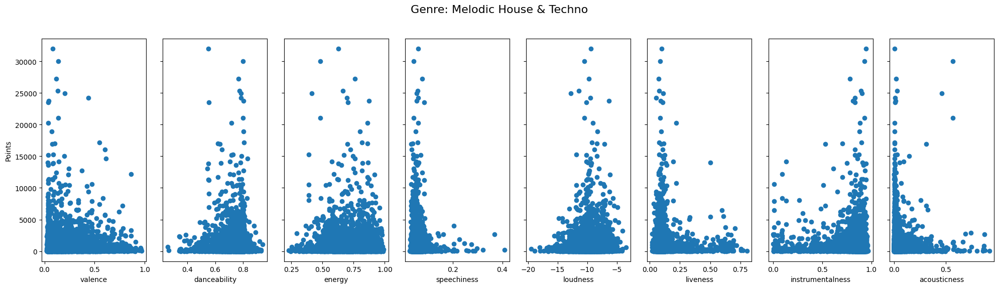

Genre: Organic House / Downtempo
x_features shape: (3817, 8)
y_points shape: (3817, 1)


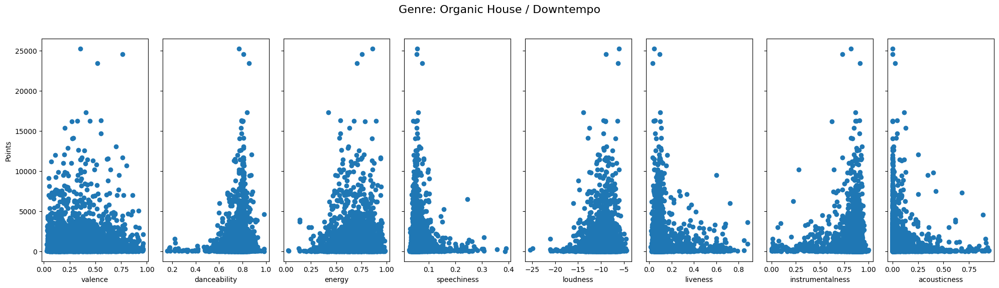

In [17]:
for genre_id in subset_genres:
    genre_matrix = toptracks_bpmeta_matrix[toptracks_bpmeta_matrix[:, toptracks_bpmeta_matrix_df_dict['genre_id_x']] == genre_id]
    x_features = genre_matrix[:, core_x_features]
    y_points = genre_matrix[:, core_y_target]
    y_points = y_points.reshape(-1, 1)

    # Check shapes 
    print(f"Genre: {subset_genres_dict[genre_id]}")
    print("x_features shape:", x_features.shape)
    print("y_points shape:", y_points.shape)

    fig, ax = plt.subplots(1, len(core_x_features), figsize=(20, 6), sharey=True)
    fig.suptitle(f'Genre: {subset_genres_dict[genre_id]}', fontsize=16)
    
    for i, feature_index in enumerate(core_x_features):
        ax[i].scatter(x_features[:, i], y_points)
        feature_name = list(toptracks_bpmeta_matrix_df_dict.keys())[list(toptracks_bpmeta_matrix_df_dict.values()).index(feature_index)]
        ax[i].set_xlabel(feature_name)
    ax[0].set_ylabel("Points")

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

#### By Label
These are pretty small datasets once you filter for top songs and then label. Probably gonna cause me issues a little further down when it's time to run gradient descent.

Label: Ajunadeep
x_features shape: (430, 8)
y_points shape: (430, 1)


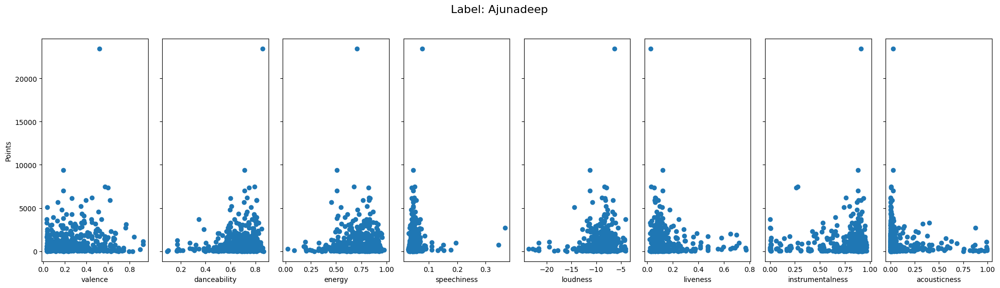

Label: All Day I Dream
x_features shape: (327, 8)
y_points shape: (327, 1)


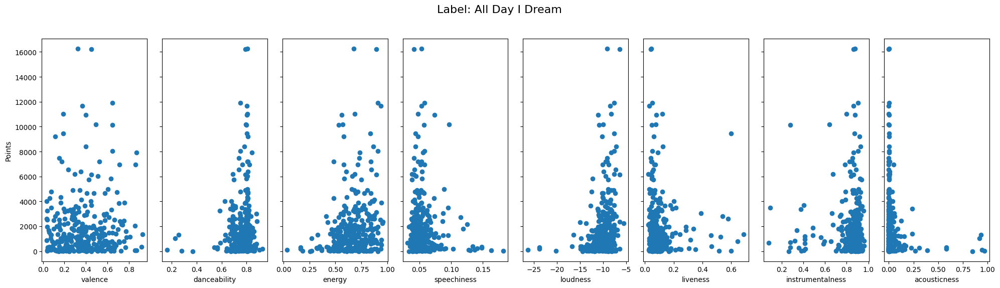

Label: Drumcode
x_features shape: (338, 8)
y_points shape: (338, 1)


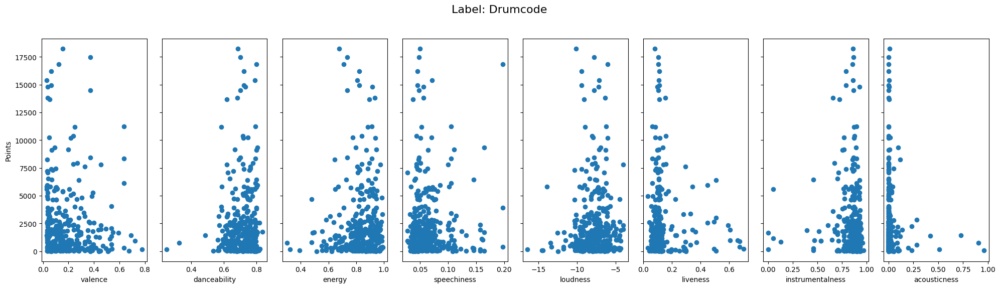

Label: Afterlife Records
x_features shape: (282, 8)
y_points shape: (282, 1)


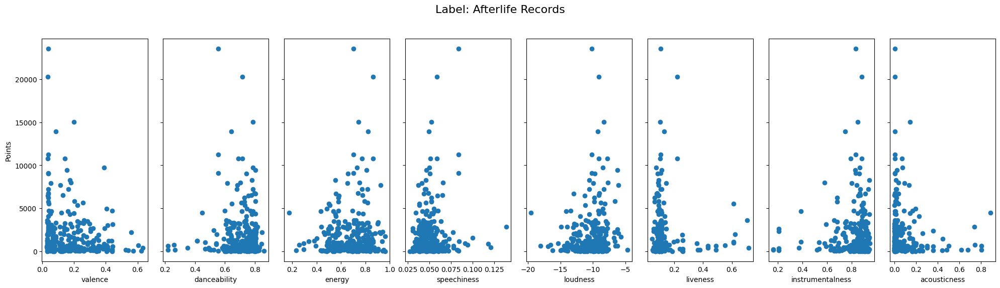

In [18]:
for label_id in subset_labels:
    label_matrix = toptracks_bpmeta_matrix[toptracks_bpmeta_matrix[:, toptracks_bpmeta_matrix_df_dict['label_id']] == label_id]
    x_features = label_matrix[:, core_x_features]
    y_points = label_matrix[:, core_y_target]
    y_points = y_points.reshape(-1, 1)

    # Check shapes 
    print(f"Label: {label_ids_dict[label_id]}")
    print("x_features shape:", x_features.shape)
    print("y_points shape:", y_points.shape)

    fig, ax = plt.subplots(1, len(core_x_features), figsize=(20, 6), sharey=True)
    fig.suptitle(f'Label: {label_ids_dict[label_id]}', fontsize=16)
    
    for i, feature_index in enumerate(core_x_features):
        ax[i].scatter(x_features[:, i], y_points)
        feature_name = list(toptracks_bpmeta_matrix_df_dict.keys())[list(toptracks_bpmeta_matrix_df_dict.values()).index(feature_index)]
        ax[i].set_xlabel(feature_name)
    ax[0].set_ylabel("Points")

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

## Running different normalization methods and reviewing the data

### Z-Score normalization 
I got the idea for these before/after charts from deeplearning.ai and I just adapted it for my work. Kinda cool to see the before and after of what's going on.

#### By Genre

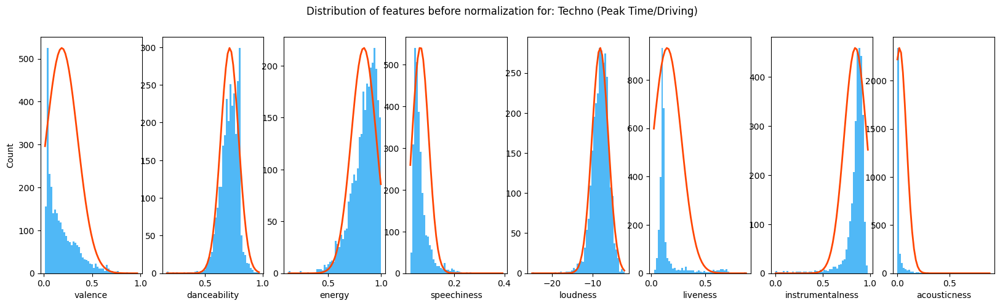

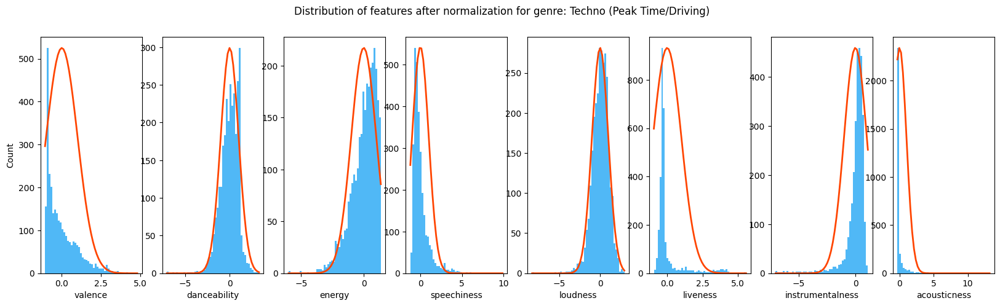

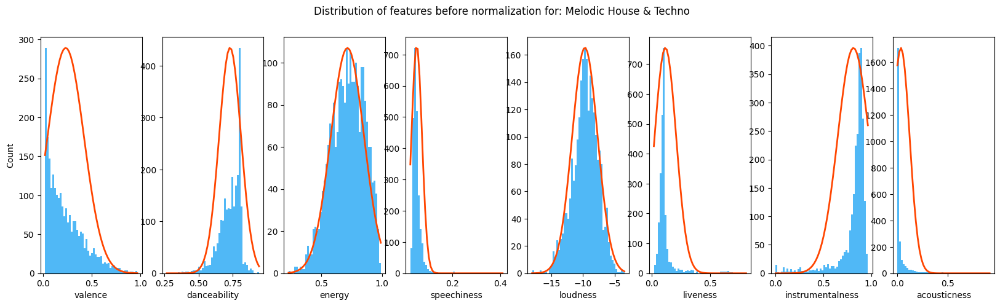

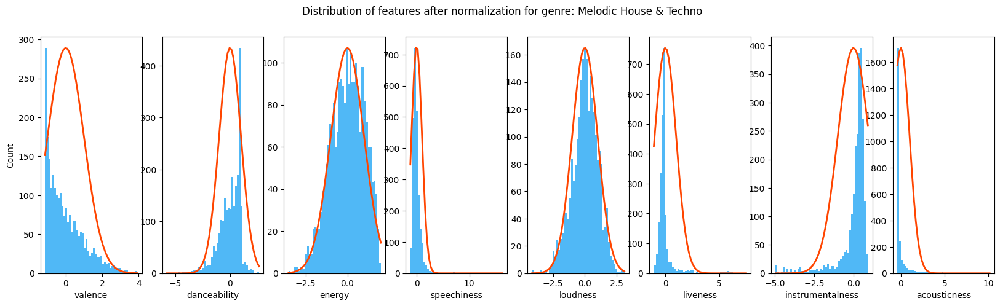

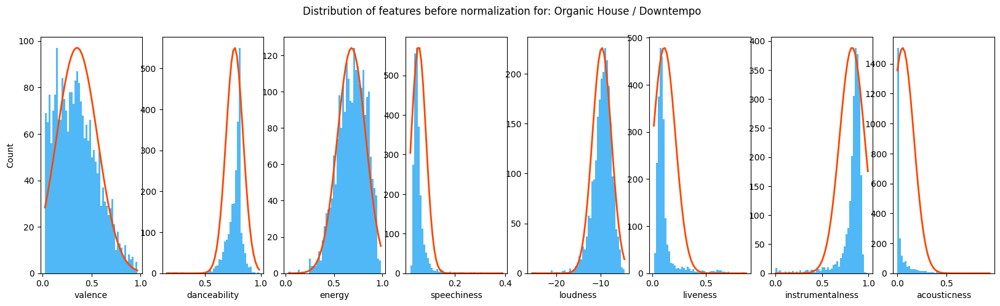

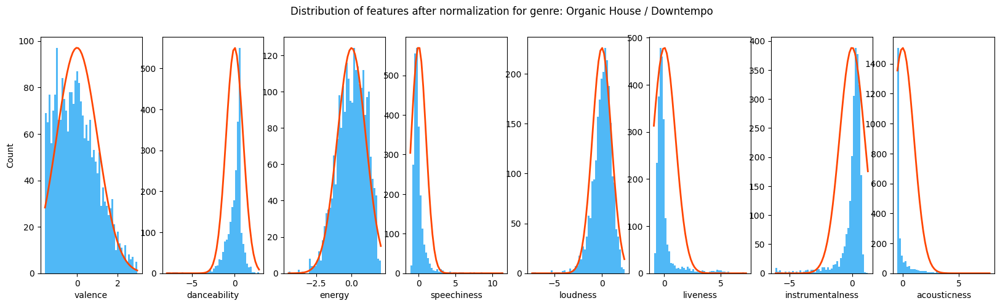

In [19]:
for genre_id in subset_genres:
    genre_matrix = zscore_train[zscore_train[:, toptracks_bpmeta_matrix_df_dict['genre_id_x']] == genre_id]
    x_features = genre_matrix[:, core_x_features]
    x_norm, feature_mean, standard_deviation = zscore_normalize(x_features)

    # Plot before normalization
    fig, ax = plt.subplots(1, len(core_x_features), figsize=(20, 5))
    for i in range(len(ax)):
        norm_plot(ax[i], x_features[:, i])
        ax[i].set_xlabel(list(toptracks_bpmeta_matrix_df_dict.keys())[list(toptracks_bpmeta_matrix_df_dict.values()).index(core_x_features[i])])
    ax[0].set_ylabel("Count")
    fig.suptitle(f"Distribution of features before normalization for: {subset_genres_dict[genre_id]}")
    plt.show()

    # Plot after normalization
    fig, ax = plt.subplots(1, len(core_x_features), figsize=(20, 5))
    for i in range(len(ax)):
        norm_plot(ax[i], x_norm[:, i])
        ax[i].set_xlabel(list(toptracks_bpmeta_matrix_df_dict.keys())[list(toptracks_bpmeta_matrix_df_dict.values()).index(core_x_features[i])])
    ax[0].set_ylabel("Count")
    fig.suptitle(f"Distribution of features after normalization for genre: {subset_genres_dict[genre_id]}")
    plt.show()


#### By Label 

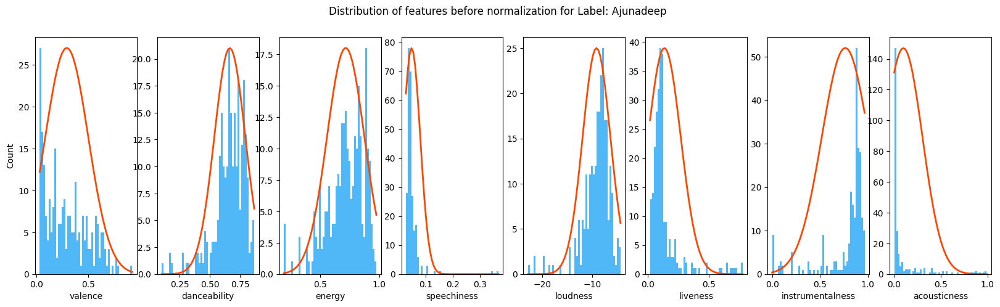

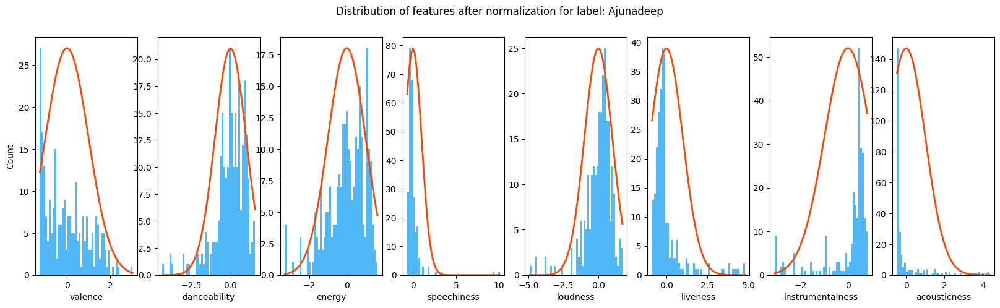

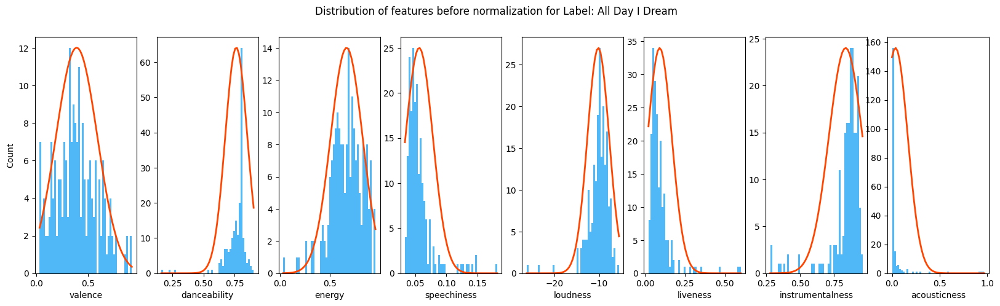

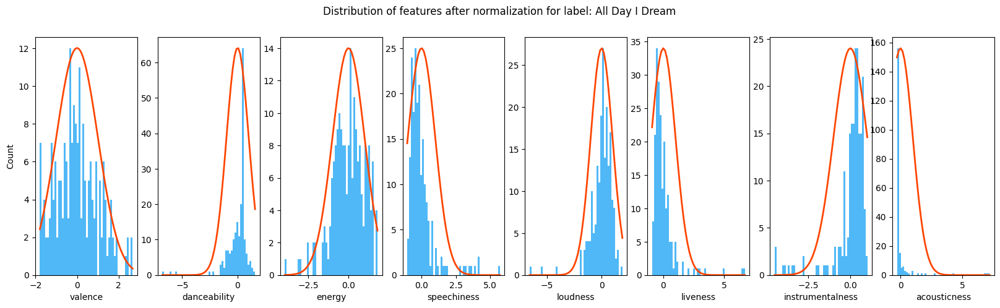

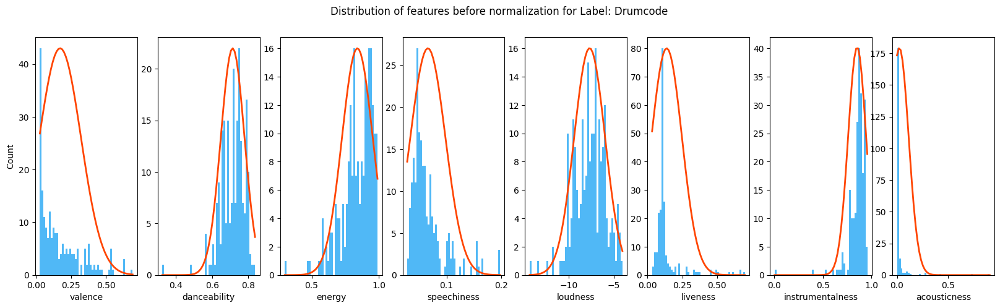

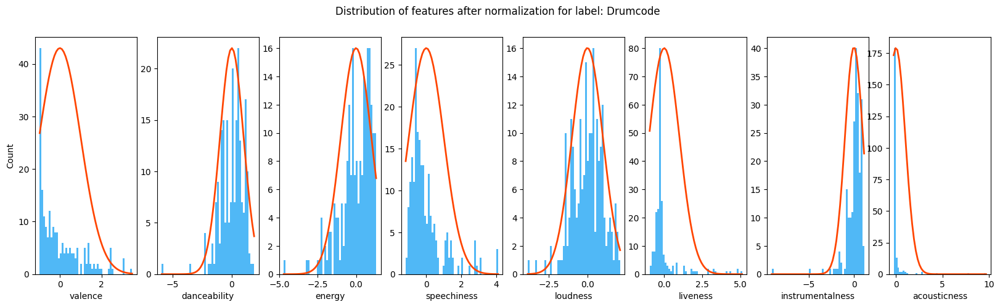

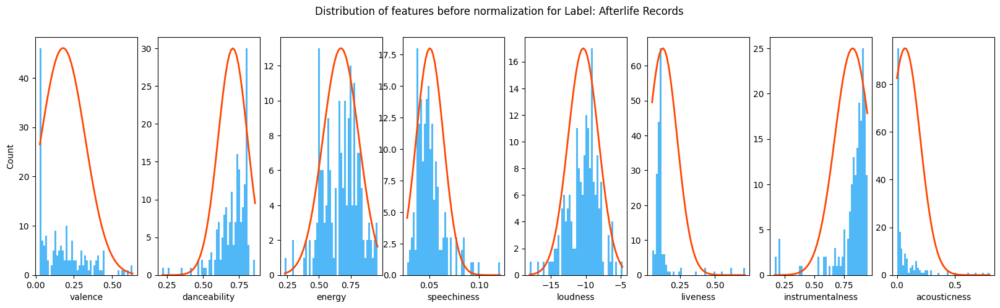

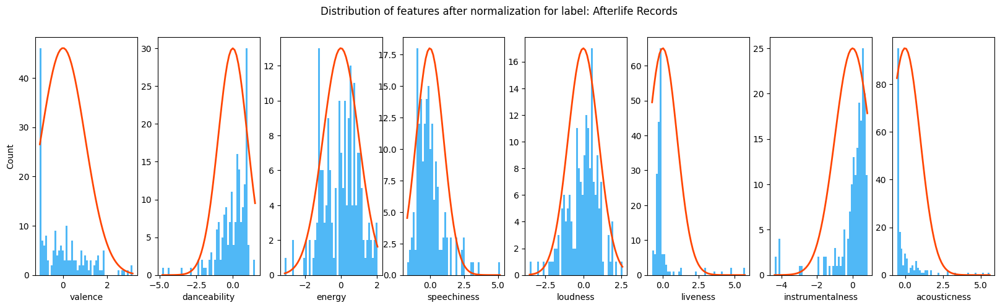

In [20]:
for label_id in subset_labels:
    label_matrix = zscore_train[zscore_train[:, toptracks_bpmeta_matrix_df_dict['label_id']] == label_id]
    x_features = label_matrix[:, core_x_features]
    x_norm, feature_mean, standard_deviation = zscore_normalize(x_features)

    # Plot before normalization
    fig, ax = plt.subplots(1, len(core_x_features), figsize=(20, 5))
    for i in range(len(ax)):
        norm_plot(ax[i], x_features[:, i])
        ax[i].set_xlabel(list(toptracks_bpmeta_matrix_df_dict.keys())[list(toptracks_bpmeta_matrix_df_dict.values()).index(core_x_features[i])])
    ax[0].set_ylabel("Count")
    fig.suptitle(f"Distribution of features before normalization for Label: {label_ids_dict[label_id]}")
    plt.show()

    # Plot after normalization
    fig, ax = plt.subplots(1, len(core_x_features), figsize=(20, 5))
    for i in range(len(ax)):
        norm_plot(ax[i], x_norm[:, i])
        ax[i].set_xlabel(list(toptracks_bpmeta_matrix_df_dict.keys())[list(toptracks_bpmeta_matrix_df_dict.values()).index(core_x_features[i])])
    ax[0].set_ylabel("Count")
    fig.suptitle(f"Distribution of features after normalization for label: {label_ids_dict[label_id]}")
    plt.show()

### Mean normalization

#### By Genre

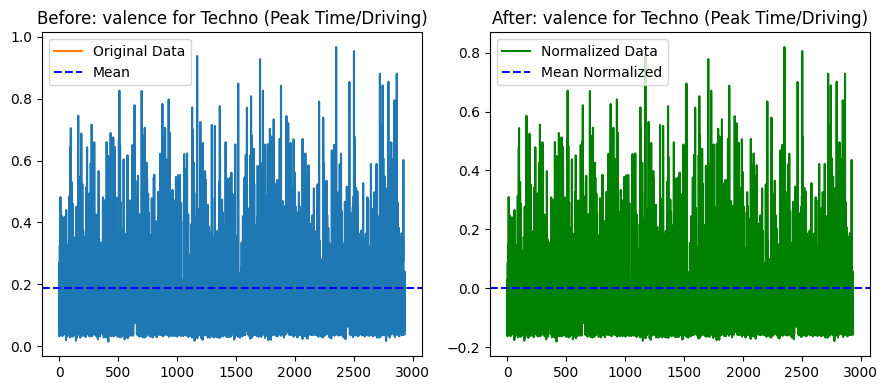

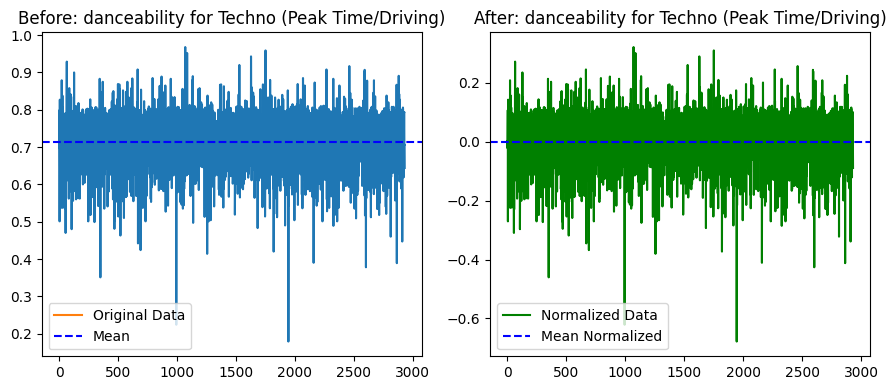

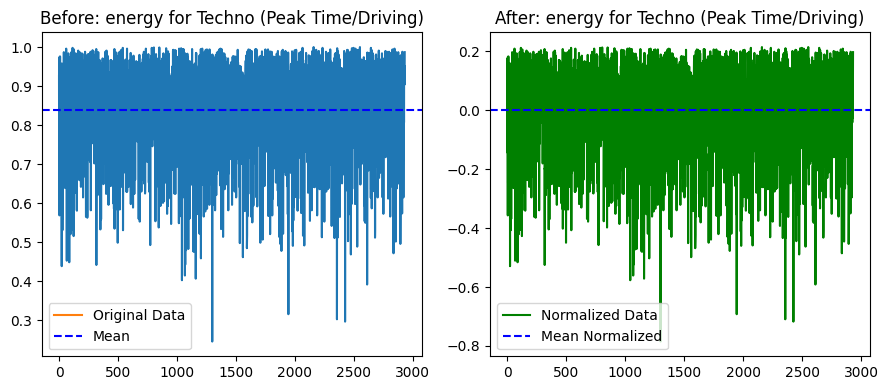

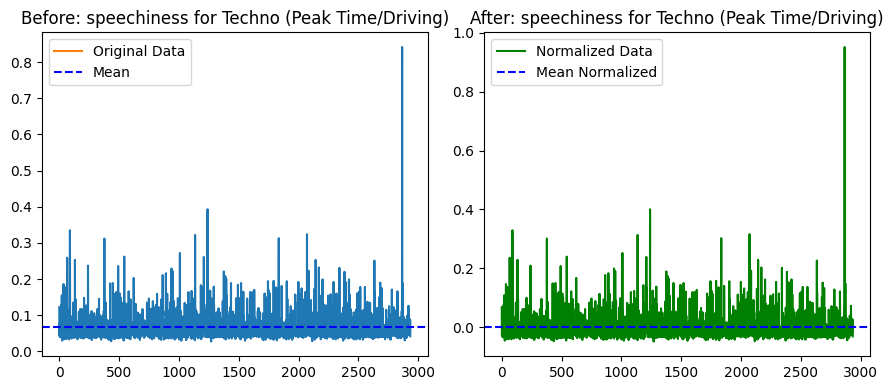

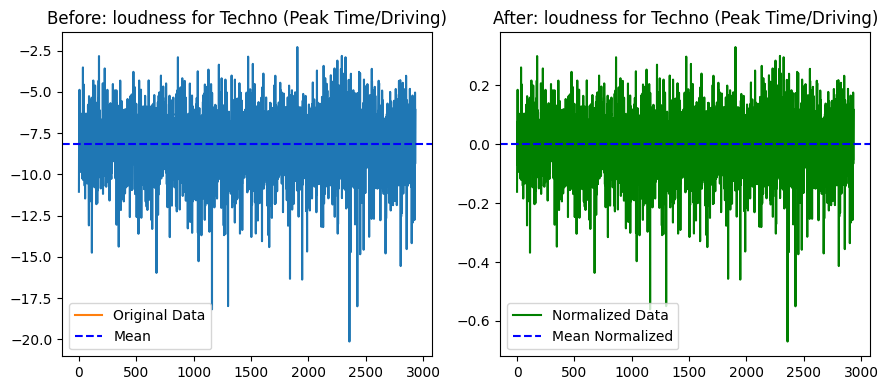

...

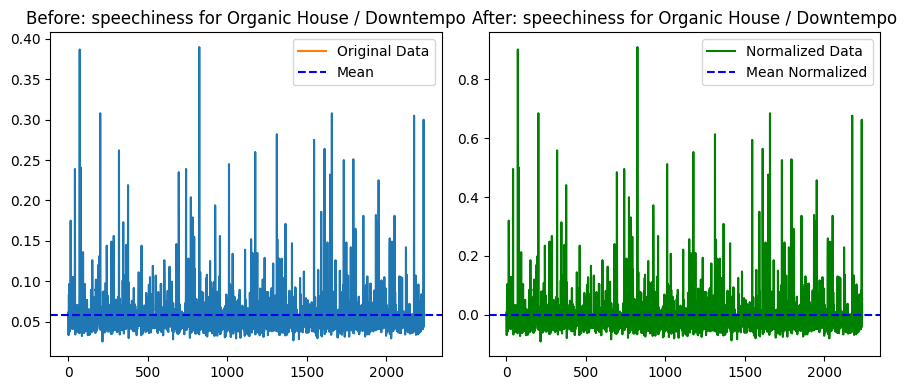

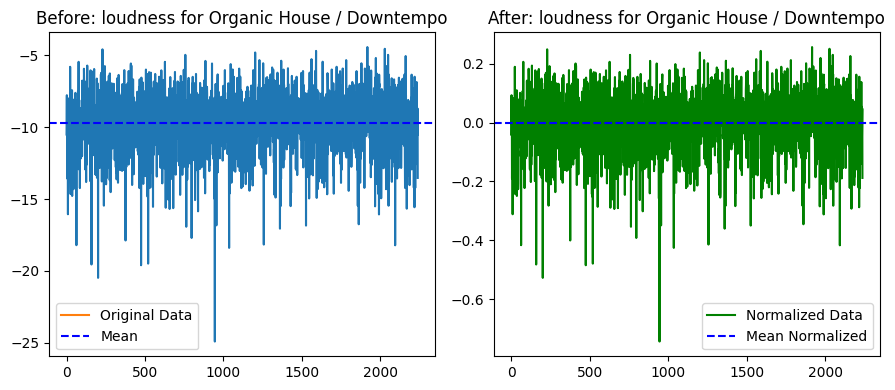

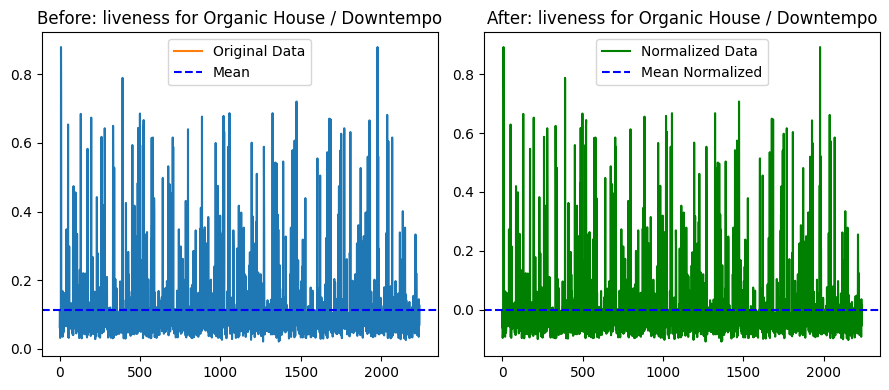

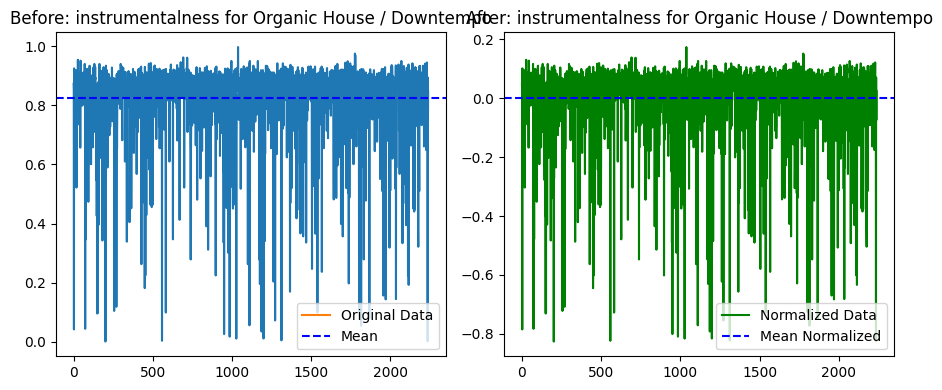

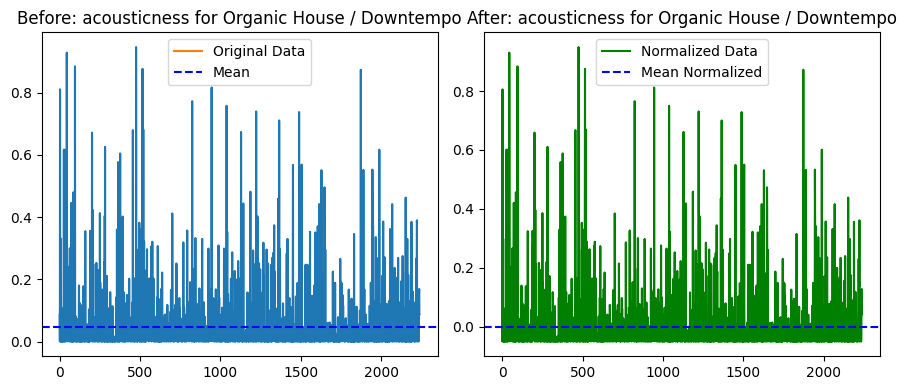

In [21]:
#by genre
for genre_id in subset_genres:
    genre_name = subset_genres_dict.get(genre_id, f"Genre {genre_id}")
    genre_matrix = mean_train[mean_train[:, toptracks_bpmeta_matrix_df_dict['genre_id_x']] == genre_id]
    x_features = genre_matrix[:, core_x_features]
    for i, feature_index in enumerate(core_x_features):
        feature = genre_matrix[:, feature_index]
        feature_name = list(toptracks_bpmeta_matrix_df_dict.keys())[list(toptracks_bpmeta_matrix_df_dict.values()).index(feature_index)]
        title = f"{feature_name} for {genre_name}"
        mean_plot(feature, title)

#### By Label

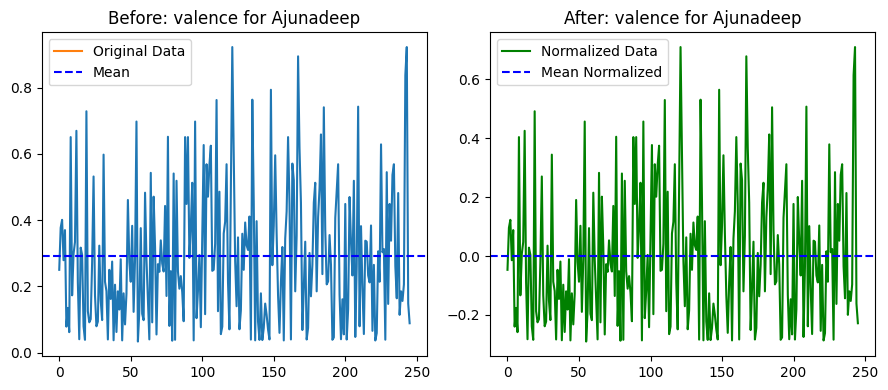

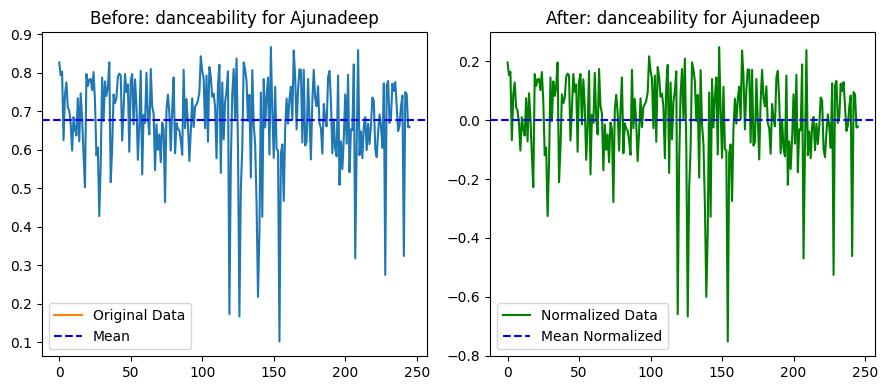

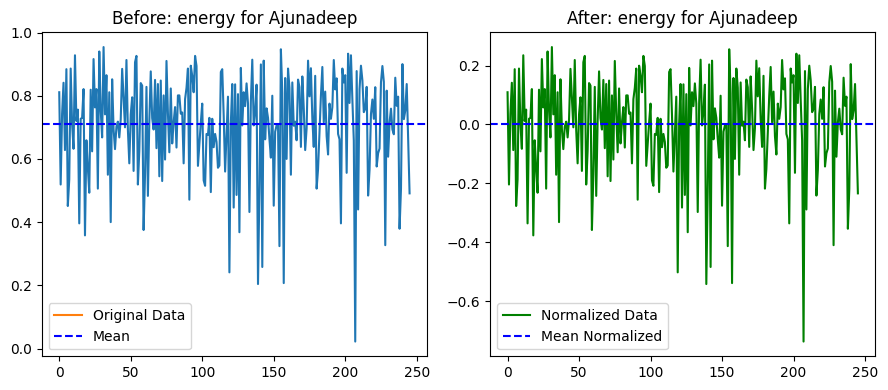

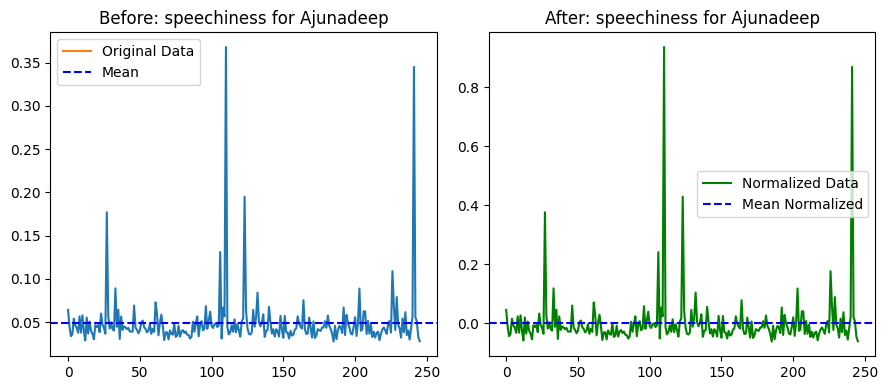

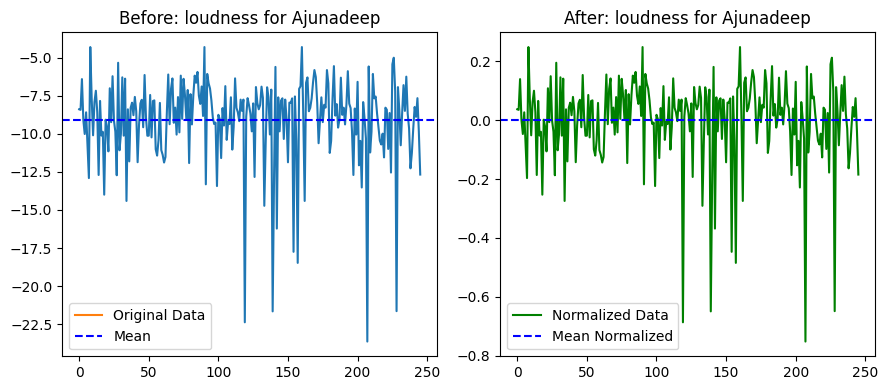

...

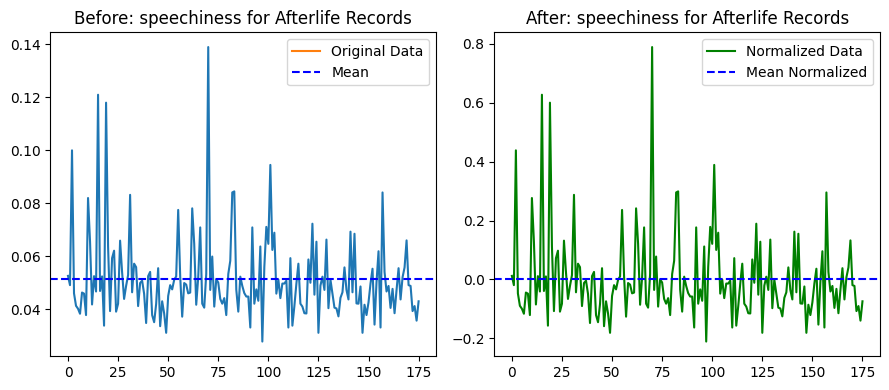

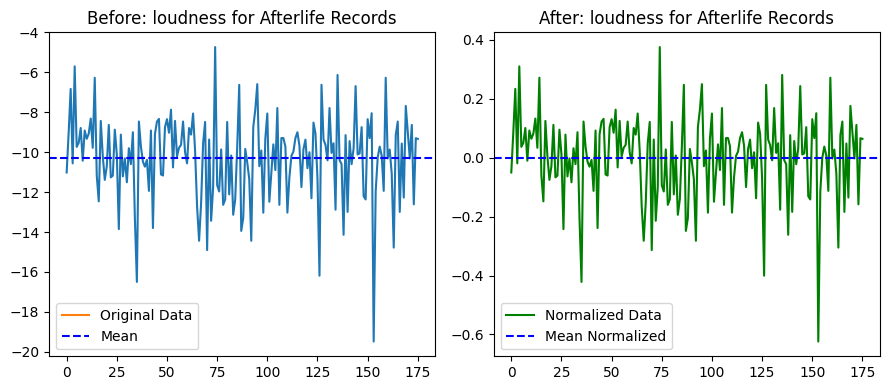

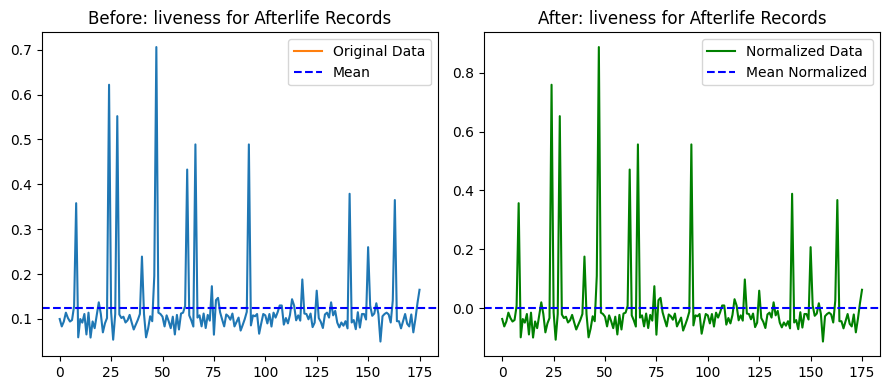

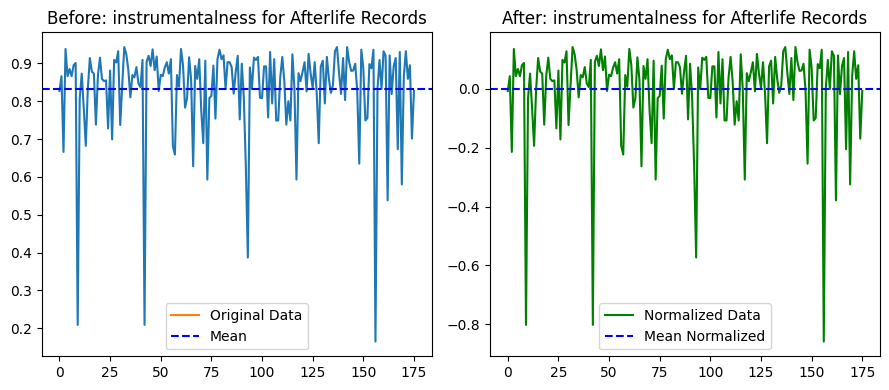

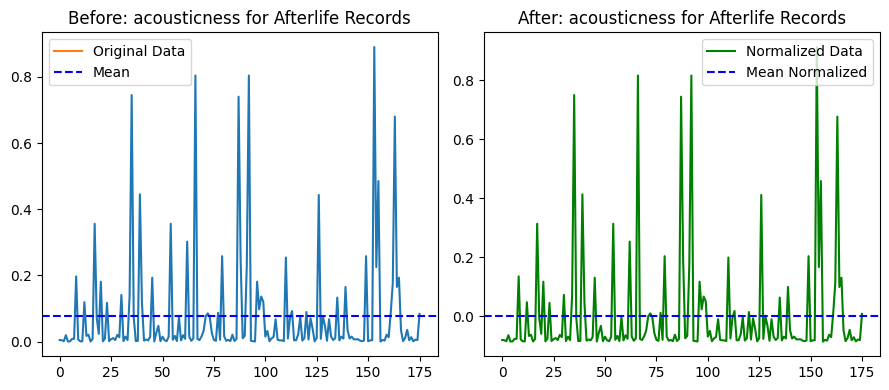

In [34]:
#by label
for label_id in subset_labels:
    label_name = label_ids_dict[label_id] 
    label_matrix = mean_train[mean_train[:, toptracks_bpmeta_matrix_df_dict['label_id']] == label_id]
    x_features = label_matrix[:, core_x_features]
    for i, feature_index in enumerate(core_x_features):
        feature = label_matrix[:, feature_index]
        feature_name = list(toptracks_bpmeta_matrix_df_dict.keys())[list(toptracks_bpmeta_matrix_df_dict.values()).index(feature_index)]
        title = f"{feature_name} for {label_name}"
        mean_plot(feature, title)

### Log Normalized

Loudness is a metric that, by default, has values ranging from positive to negative and so the charts don't populate. When I have some more knowledge and skills, I'll see if there's a way to handle values that range below -1 (the +1 in the definition above covers for -1 to zero). A bit out of my skillset range for now so I'm gonna let it rest.

#### By Genre

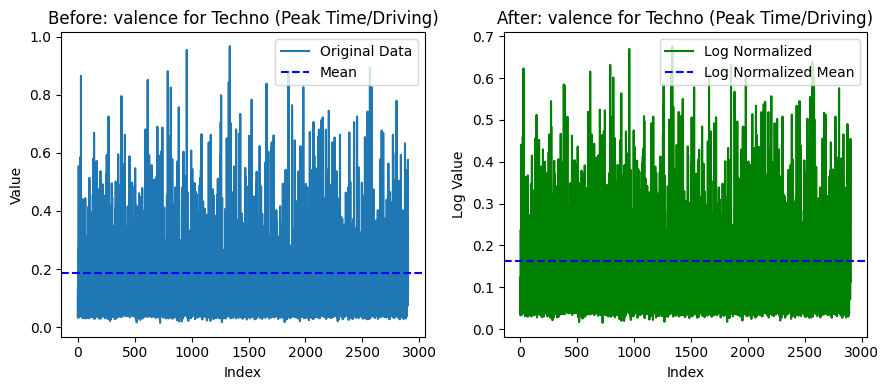

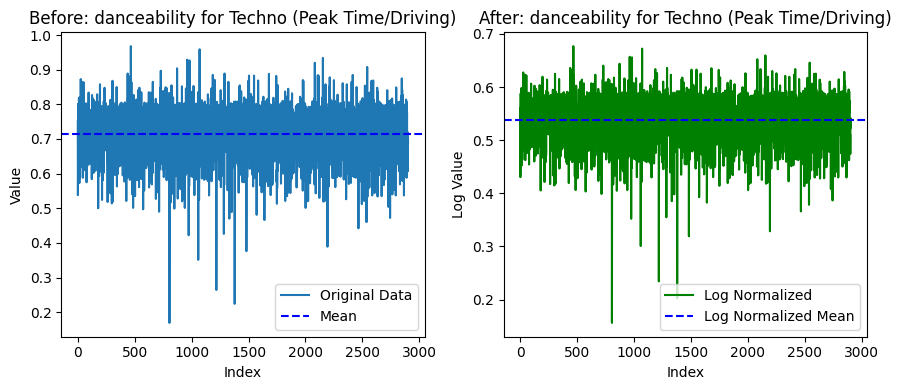

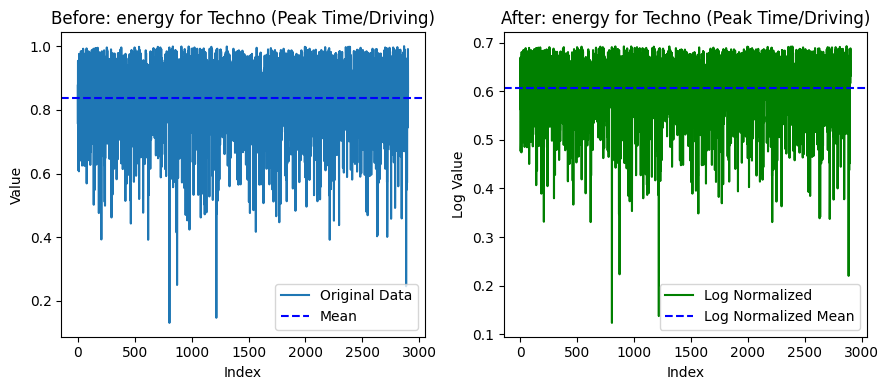

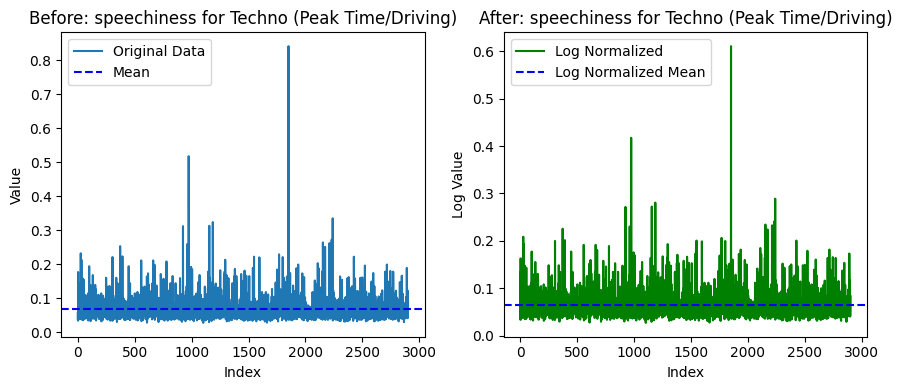

/var/folders/2q/1m0wb0x5547gycyp2q9vyy340000gn/T/ipykernel_2455/1217021281.py:2: RuntimeWarning: invalid value encountered in log
  x_log = lumpnump.log(x + 1)


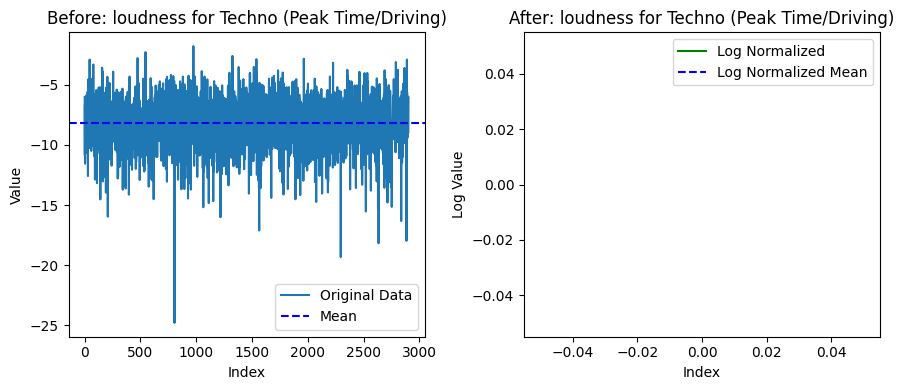

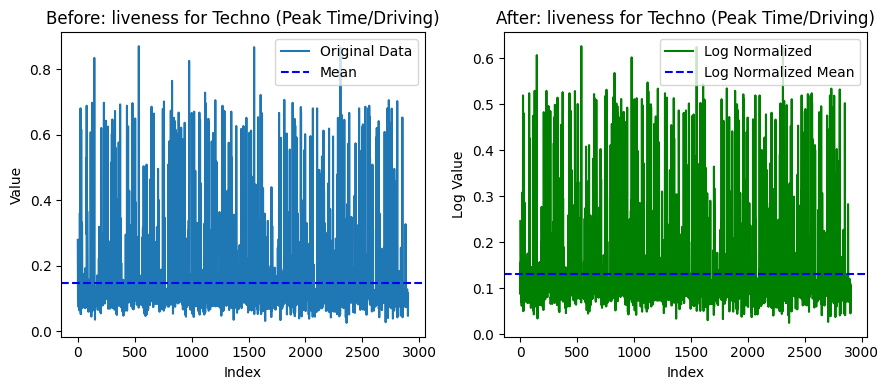

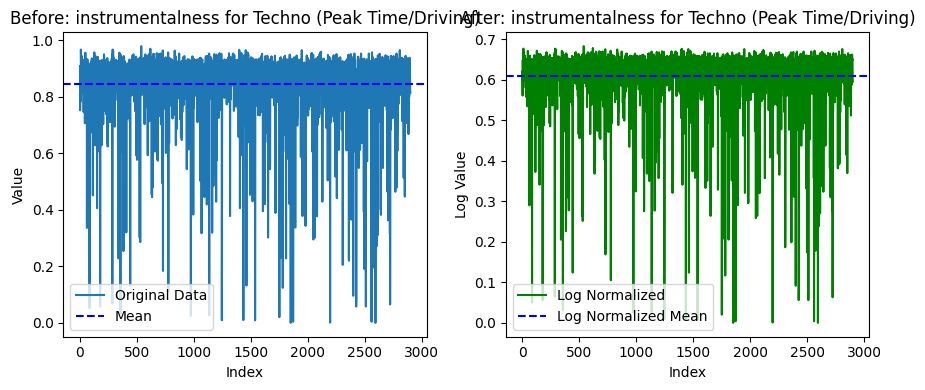

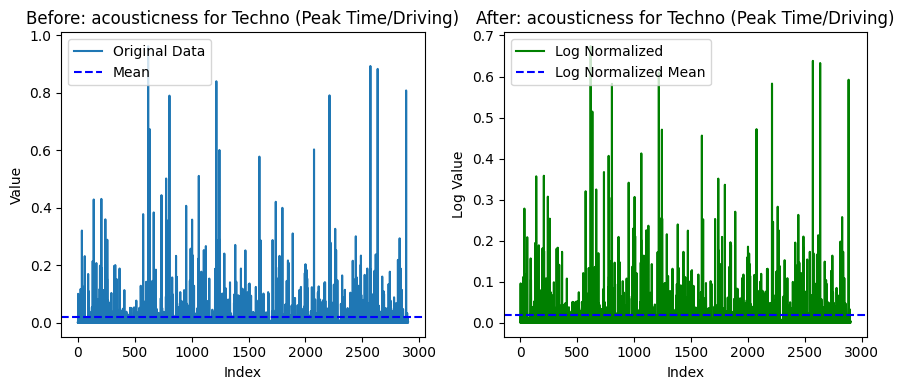

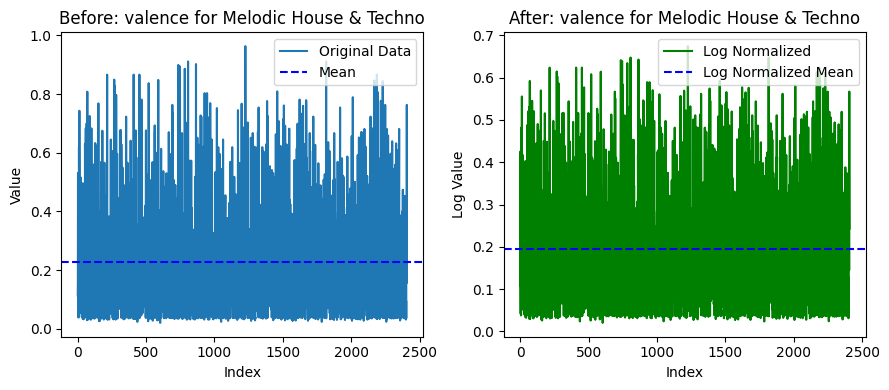

...

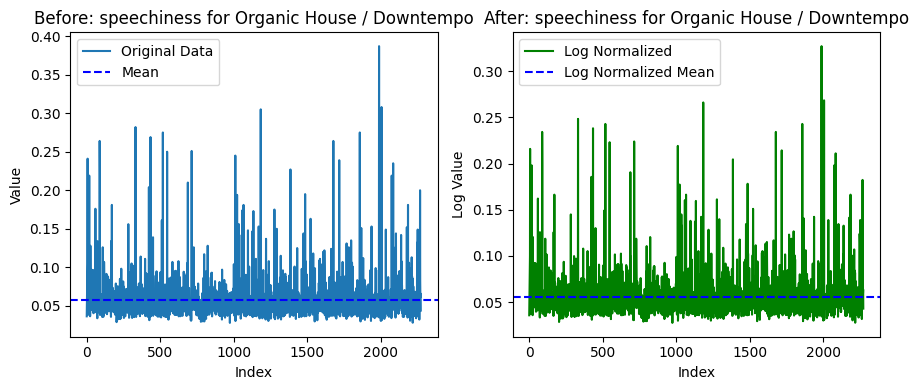

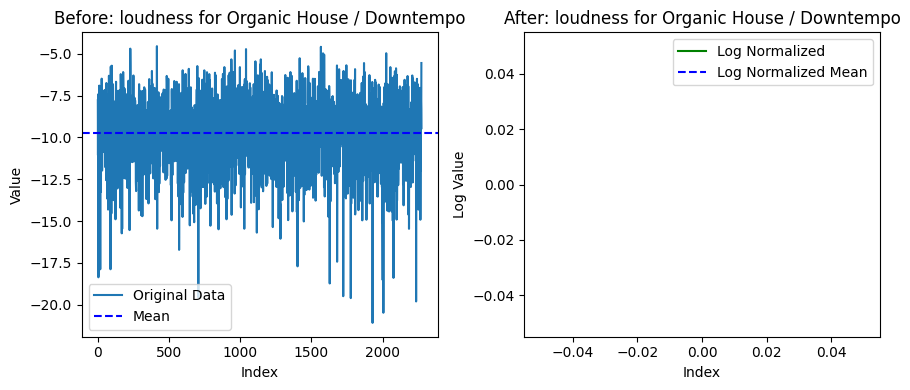

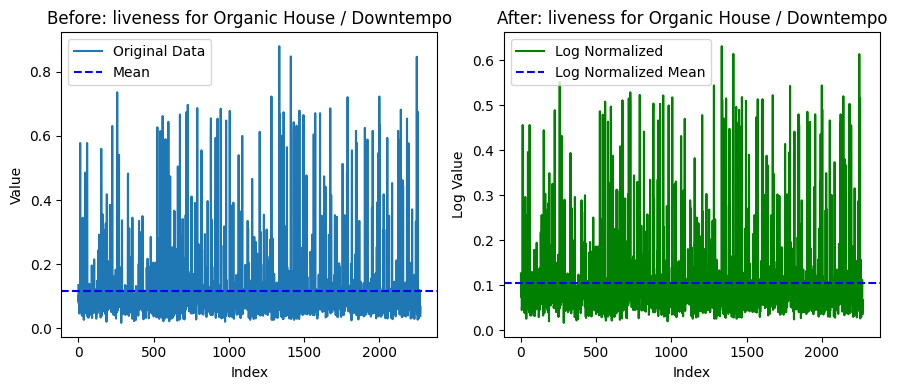

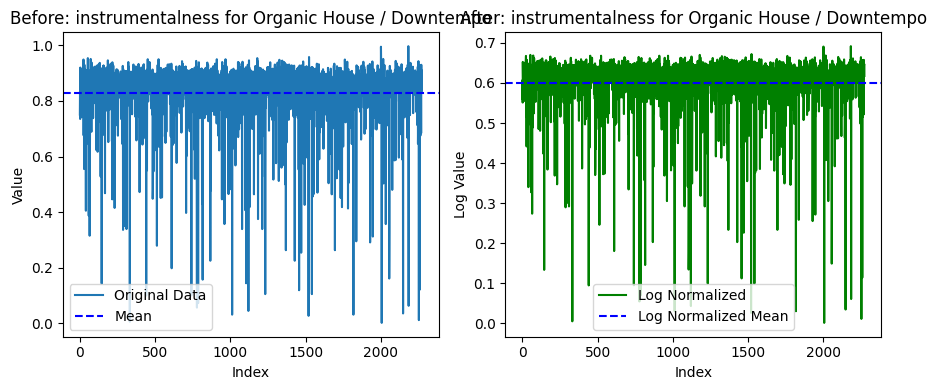

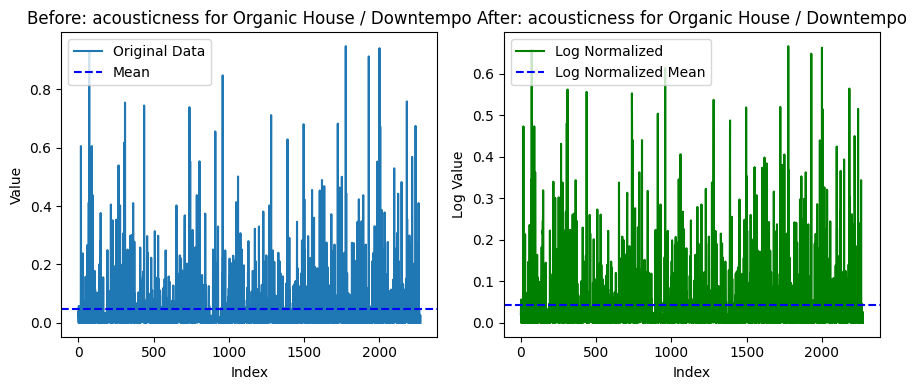

In [23]:
#by genre
for genre_id in subset_genres:
    genre_name = subset_genres_dict.get(genre_id, f"Genre {genre_id}")
    genre_matrix = log_train[log_train[:, toptracks_bpmeta_matrix_df_dict['genre_id_x']] == genre_id]
    x_features = genre_matrix[:, core_x_features]
    for i, feature_index in enumerate(core_x_features):
        feature = genre_matrix[:, feature_index]
        feature_name = list(toptracks_bpmeta_matrix_df_dict.keys())[list(toptracks_bpmeta_matrix_df_dict.values()).index(feature_index)]
        title = f"{feature_name} for {genre_name}"
        log_plot(feature, title)

#### By Label

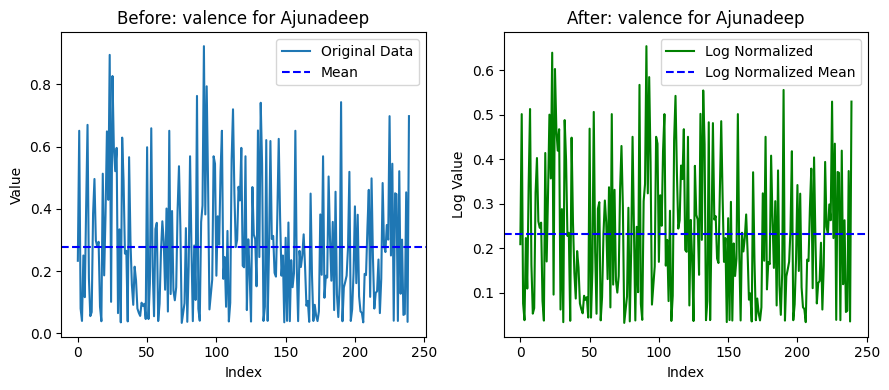

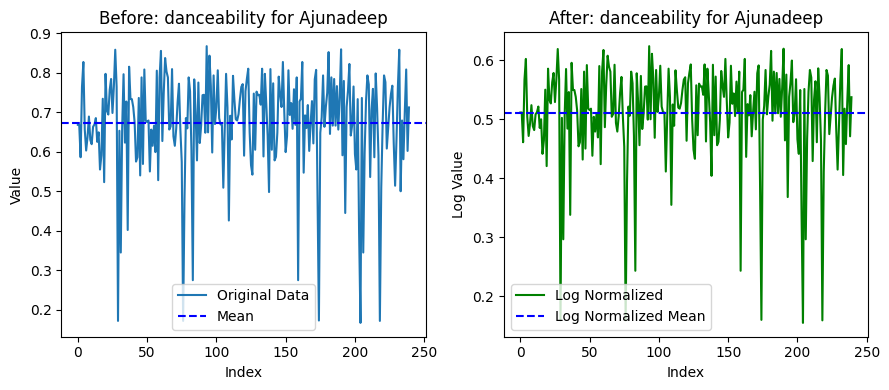

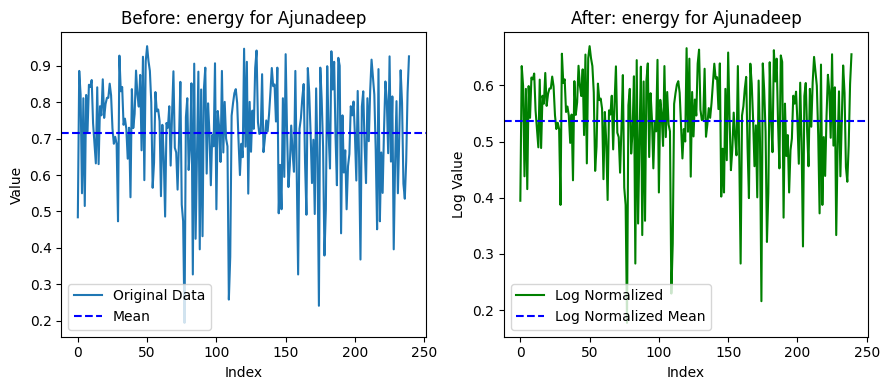

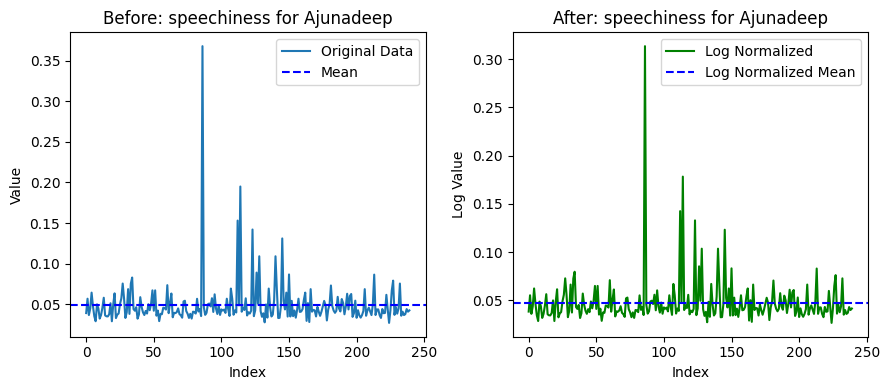

/var/folders/2q/1m0wb0x5547gycyp2q9vyy340000gn/T/ipykernel_2455/1217021281.py:2: RuntimeWarning: invalid value encountered in log
  x_log = lumpnump.log(x + 1)


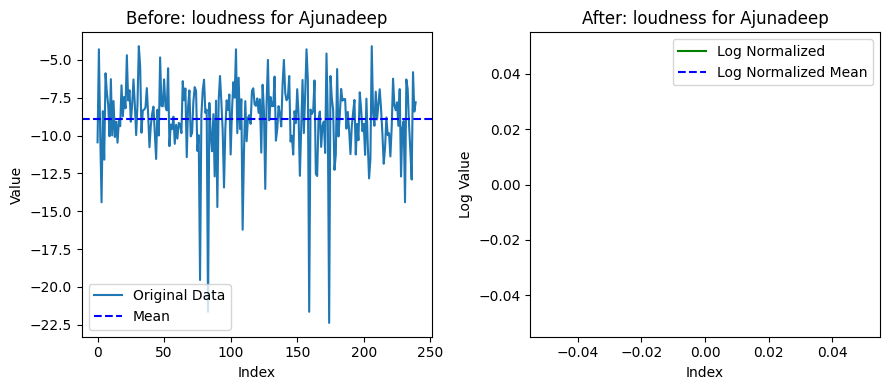

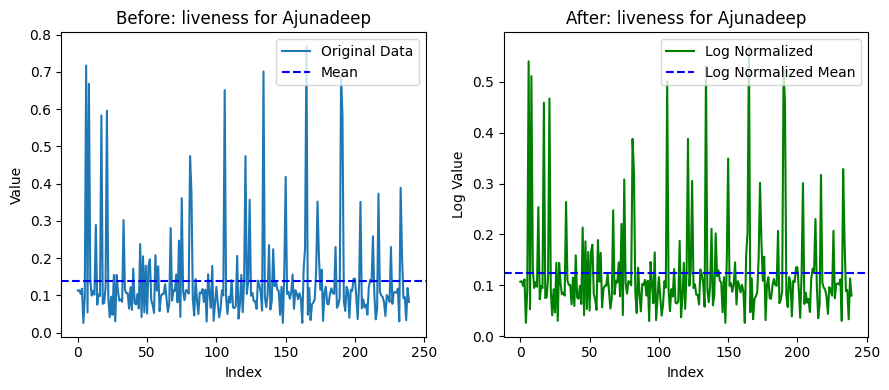

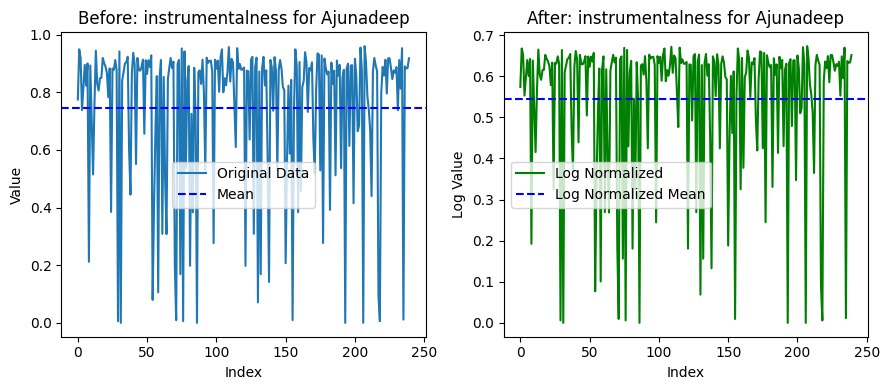

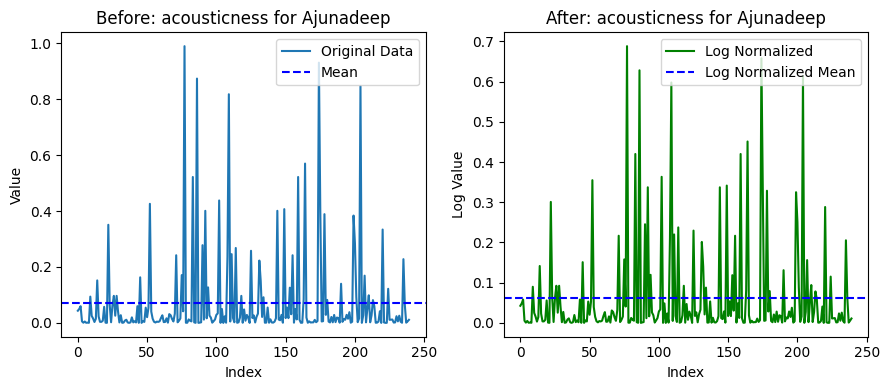

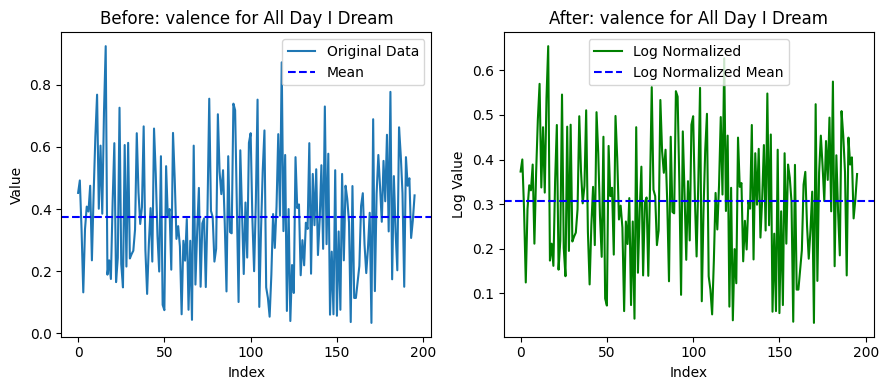

...

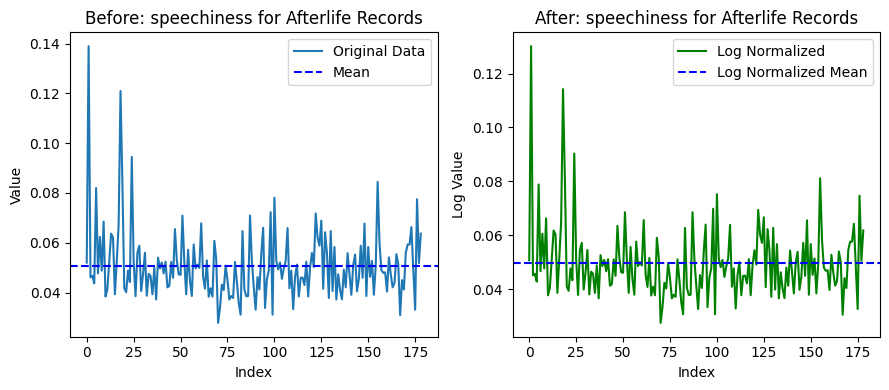

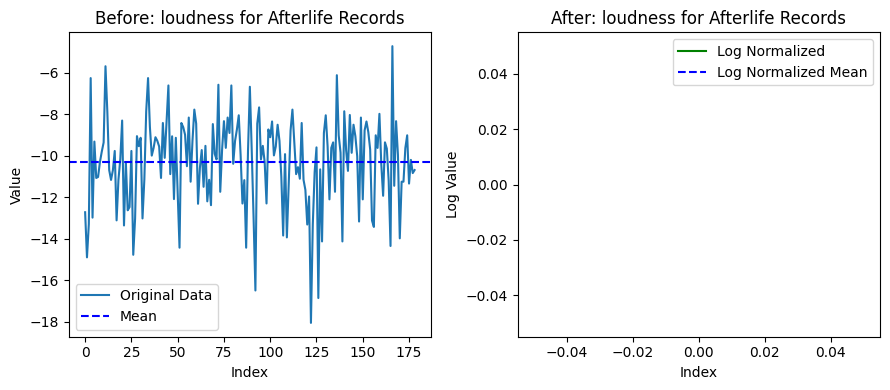

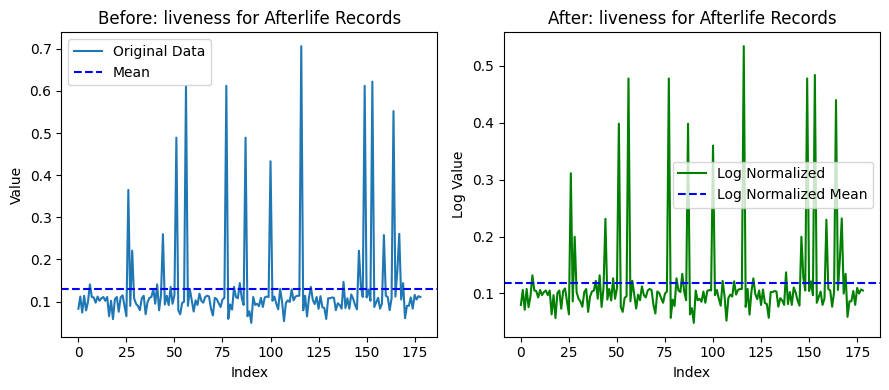

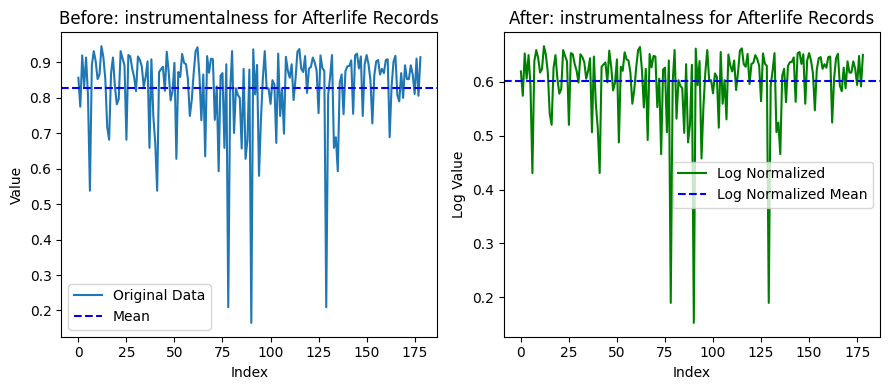

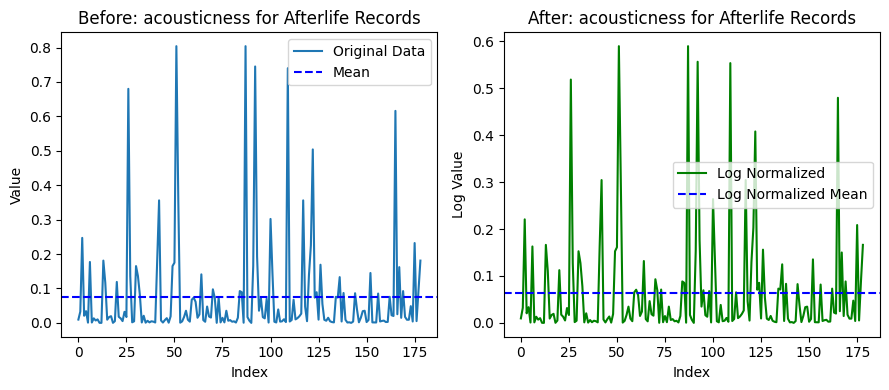

In [24]:
#by label
for label_id in subset_labels:
    label_name = label_ids_dict.get(label_id, f"Label {label_id}")
    label_matrix = log_train[log_train[:, toptracks_bpmeta_matrix_df_dict['label_id']] == label_id]
    x_features = label_matrix[:, core_x_features]
    for i, feature_index in enumerate(core_x_features):
        feature = label_matrix[:, feature_index]
        feature_name = list(toptracks_bpmeta_matrix_df_dict.keys())[list(toptracks_bpmeta_matrix_df_dict.values()).index(feature_index)]
        title = f"{feature_name} for {label_name}"
        log_plot(feature, title)

## Running cost function, gradient, and gradient descent for each normalized data set

### define function for genre data
Deep breath: in one big function, this calculates initial costs and gradients, runs gradient descent, and then graphs the fit lines against train/validate/test sets. I put this all together because I was making a lot of changes and was getting tired of rerunning different pieces. The different components are defined separately above so, if there's an error, it almost always traced to a component I could fix in isolation.

The biggest downside to this approach is that all the metrics are using the same w and lamda inputs, which isn't ideal. However, for the first round of work I was ok with this since I'm still getting oriented. In the next round of work, I'll change this type of function up a bit to have more flexibility in these inputs. I also want to get into the habit of running tests on subsets that involve different w and lambda inputs. 

In [35]:
def run_all_calculations_genre(train, validate, test):
    genre_cost_histories = {}
    genre_w_histories = {}
    table_data = {}

    for genre_id in subset_genres:
        genre_name = subset_genres_dict[genre_id]  # Look up the genre name
        train_genre_mask = (train[:, 7] == genre_id)
        validate_genre_mask = (validate[:, 7] == genre_id)
        test_genre_mask = (test[:, 7] == genre_id)
        
        # Loop through each metric index
        for feature in core_x_features:
            # Apply genre_id filter to points and metric
            x_train = train[train_genre_mask, feature].reshape(-1, 1)
            x_validate = validate[validate_genre_mask, feature].reshape(-1, 1)
            x_test = test[test_genre_mask, feature].reshape(-1, 1)
            
            y_train = train[train_genre_mask, 28]
            y_validate = validate[validate_genre_mask, 28]
            y_test = test[test_genre_mask, 28]
            
            metric_name = [key for key, value in toptracks_bpmeta_matrix_df_dict.items() if value == feature][0]
            
            # Cost function initial w and b
            cost_function_w = lumpnump.array([2.0])
            cost_function_b = 1.0
            cost_function_lambdar = 0.7
    
            # Run cost function
            cost = single_var_cost_function(x_train, y_train, cost_function_w, cost_function_b, cost_function_lambdar)
            print(f'Cost for {genre_name} and {metric_name} at initial w: {cost}')
            
            # Gradient + gradient descent w, b, learning rate
            gradient_w = lumpnump.array([0.0])
            gradient_b = 0.
            learning_rate = 0.001
            iterations = 150
            gradient_lambdar = 0.7
    
            # Run gradient function
            tmp_dj_dw, tmp_dj_db = single_var_compute_gradient(x_train, y_train, gradient_w, gradient_b, gradient_lambdar)
            print(f'Gradient at initial w & b for {genre_name} and {metric_name}:', tmp_dj_dw, tmp_dj_db)
            
            # Run gradient descent
            optimal_w, optimal_b, cost_history, w_history = single_var_gradient_descent(x_train, y_train, gradient_w, gradient_b, 
                                                     single_var_cost_function, single_var_compute_gradient, learning_rate, iterations, gradient_lambdar)
            print(f"Optimal w & b found by gradient descent for {metric_name} for {genre_name}:", optimal_w, optimal_b)

            genre_cost_histories[f'{genre_name}-{metric_name}'] = cost_history
            genre_w_histories[f'{genre_name}-{metric_name}'] = w_history

            # Store cost history in table format
            for iteration, cost in enumerate(cost_history):
                if iteration not in table_data:
                    table_data[iteration] = {}
                table_data[iteration][f'{genre_name}-{metric_name}'] = cost

    fig, axs = plt.subplots(2, 1, figsize=(18, 12))
    colors = plt.cm.rainbow(lumpnump.linspace(0, 1, len(genre_cost_histories)))
    
    lines = []
    for i, (label, cost_history) in enumerate(genre_cost_histories.items()):
        line, = axs[0].plot(range(len(cost_history)), cost_history, label=label, color=colors[i])
        lines.append(line)
    
    for i, (label, w_history) in enumerate(genre_w_histories.items()):  
        line, = axs[1].plot(range(len(w_history)), [w_i[0] for w_i in w_history], label=label, color=colors[i])
        lines.append(line)
    
    axs[0].set_title("Cost vs Iteration")
    axs[0].set_xlabel("Iteration")
    axs[0].set_ylabel("Cost")
    
    axs[1].set_title("Cost vs W")
    axs[1].set_xlabel("Iteration")
    axs[1].set_ylabel("Cost")
    
    # Move the legend above the plot
    handles, labels = axs[0].get_legend_handles_labels()
    fig.legend(handles, labels, loc='upper center', bbox_to_anchor=(0.5, 1.1), ncol=3)
    
    plt.tight_layout(rect=[0, 0, 1, 0.95])

    plt.show()

    # Plotting scatter plots for each genre and metric
    for genre_id in subset_genres:
        genre_name = subset_genres_dict[genre_id]
        for feature in core_x_features:
            metric_name = [key for key, value in toptracks_bpmeta_matrix_df_dict.items() if value == feature][0]
            
            x_train = train[(train[:, 7] == genre_id), feature].reshape(-1, 1)
            y_train = train[(train[:, 7] == genre_id), 28]
            x_validate = validate[(validate[:, 7] == genre_id), feature].reshape(-1, 1)
            y_validate = validate[(validate[:, 7] == genre_id), 28]
            x_test = test[(test[:, 7] == genre_id), feature].reshape(-1, 1)
            y_test = test[(test[:, 7] == genre_id), 28]

            optimal_w = lumpnump.array([2.0])
            optimal_b = 1.0
            
            train_prediction = optimal_w * x_train + optimal_b
            validate_prediction = optimal_w * x_validate + optimal_b
            test_prediction = optimal_w * x_test + optimal_b

            # Calculate metrics for training data
            train_mse = lumpnump.mean((y_train - train_prediction) ** 2)
            train_rmse = lumpnump.sqrt(train_mse)
            train_mae = lumpnump.mean(lumpnump.abs(y_train - train_prediction))
            train_r2 = 1 - (lumpnump.sum((y_train - train_prediction) ** 2) / lumpnump.sum((y_train - lumpnump.mean(y_train)) ** 2))
            
            # Validation data
            validate_mse = lumpnump.mean((y_validate - validate_prediction) ** 2)
            validate_rmse = lumpnump.sqrt(validate_mse)
            validate_mae = lumpnump.mean(lumpnump.abs(y_validate - validate_prediction))
            validate_r2 = 1 - (lumpnump.sum((y_validate - validate_prediction) ** 2) / lumpnump.sum((y_validate - lumpnump.mean(y_validate)) ** 2))
            
            # Test data
            test_mse = lumpnump.mean((y_test - test_prediction) ** 2)
            test_rmse = lumpnump.sqrt(test_mse)
            test_mae = lumpnump.mean(lumpnump.abs(y_test - test_prediction))
            test_r2 = 1 - (lumpnump.sum((y_test - test_prediction) ** 2) / lumpnump.sum((y_test - lumpnump.mean(y_test)) ** 2))

            fig, axs = plt.subplots(1, 3, figsize=(18, 8))  # Create a figure with 1 row and 3 columns

            # Training data graphing with linear fit
            axs[0].scatter(x_train, y_train, marker='.', color='#10C7FF')
            axs[0].plot(x_train, train_prediction, c='r')
            axs[0].set_xlabel(metric_name)
            axs[0].set_ylabel('Points')
            axs[0].set_title(f'Training data fit for {genre_name} - {metric_name}')
            axs[0].text(0.5, -0.2, f'MSE: {train_mse:.2f}\nRMSE: {train_rmse:.2f}\nMAE: {train_mae:.2f}\nR-squared: {train_r2:.2f}',
                        ha='center', va='center', transform=axs[0].transAxes)

            # Validation data
            axs[1].scatter(x_validate, y_validate, marker='.', color='#10C7FF')
            axs[1].plot(x_validate, validate_prediction, c='r')
            axs[1].set_xlabel(metric_name)
            axs[1].set_ylabel('Points')
            axs[1].set_title(f'Validation data fit for {genre_name} - {metric_name}')
            axs[1].text(0.5, -0.2, f'MSE: {validate_mse:.2f}\nRMSE: {validate_rmse:.2f}\nMAE: {validate_mae:.2f}\nR-squared: {validate_r2:.2f}',
                        ha='center', va='center', transform=axs[1].transAxes)

            # Test data
            axs[2].scatter(x_test, y_test, marker='.', color='#10C7FF')
            axs[2].plot(x_test, test_prediction, c='r')
            axs[2].set_xlabel(metric_name)
            axs[2].set_ylabel('Points')
            axs[2].set_title(f'Test data fit for {genre_name} - {metric_name}')
            axs[2].text(0.5, -0.2, f'MSE: {test_mse:.2f}\nRMSE: {test_rmse:.2f}\nMAE: {test_mae:.2f}\nR-squared: {test_r2:.2f}',
                        ha='center', va='center', transform=axs[2].transAxes)

            # Show the plots
            plt.tight_layout()
            plt.show()

### Define function for label data

In [26]:
def run_all_calculations_label(train, validate, test):
    label_cost_histories = {}
    label_w_histories = {}
    table_data = {}

    for label_id in subset_labels:
        label_name = label_ids_dict[label_id]
        train_label_mask = (train[:, 5] == label_id)
        validate_label_mask = (validate[:, 5] == label_id)
        test_label_mask = (test[:, 5] == label_id)
        
        # Loop through each metric index
        for feature in core_x_features:
            # Apply genre_id filter to points and metric
            x_train = train[train_label_mask, feature].reshape(-1, 1)
            x_validate = validate[validate_label_mask, feature].reshape(-1, 1)
            x_test = test[test_label_mask, feature].reshape(-1, 1)
            
            y_train = train[train_label_mask, 28]
            y_validate = validate[validate_label_mask, 28]
            y_test = test[test_label_mask, 28]
            
            metric_name = [key for key, value in toptracks_bpmeta_matrix_df_dict.items() if value == feature][0]
            
            # Cost function initial w and b
            cost_function_w = lumpnump.array([2.0])
            cost_function_b = 1.0
            cost_function_lambdar = 0.7
    
            # Run cost function
            cost = single_var_cost_function(x_train, y_train, cost_function_w, cost_function_b, cost_function_lambdar)
            print(f'Cost for {label_name} and {metric_name} at initial w: {cost}')
            
            # Gradient + gradient descent w, b, learning rate
            gradient_w = lumpnump.array([0.0])
            gradient_b = 0.
            learning_rate = 0.001
            iterations = 150
            gradient_lambdar = 0.7
    
            # Run gradient function
            tmp_dj_dw, tmp_dj_db = single_var_compute_gradient(x_train, y_train, gradient_w, gradient_b, gradient_lambdar)
            print(f'Gradient at initial w & b for {label_name} and {metric_name}:', tmp_dj_dw, tmp_dj_db)
            
            # Run gradient descent
            optimal_w, optimal_b, cost_history, w_history = single_var_gradient_descent(x_train, y_train, gradient_w, gradient_b, 
                                                     single_var_cost_function, single_var_compute_gradient, learning_rate, iterations, gradient_lambdar)
            print(f"Optimal w & b found by gradient descent for {label_name} and {metric_name}", optimal_w, optimal_b)

            label_cost_histories[f'{label_name}-{metric_name}'] = cost_history
            label_w_histories[f'{label_name}-{metric_name}'] = w_history

            # Store cost history in table format
            for iteration, cost in enumerate(cost_history):
                if iteration not in table_data:
                    table_data[iteration] = {}
                table_data[iteration][f'{label_name}-{metric_name}'] = cost

    fig, axs = plt.subplots(2, 1, figsize=(18, 12))
    colors = plt.cm.rainbow(lumpnump.linspace(0, 1, len(label_cost_histories)))
    
    lines = []
    for i, (label, cost_history) in enumerate(label_cost_histories.items()):
        line, = axs[0].plot(range(len(cost_history)), cost_history, label=label, color=colors[i])
        lines.append(line)
    
    for i, (label, w_history) in enumerate(label_w_histories.items()):  
        line, = axs[1].plot(range(len(w_history)), [w_i[0] for w_i in w_history], label=label, color=colors[i])
        lines.append(line)
    
    axs[0].set_title("Cost vs Iteration")
    axs[0].set_xlabel("Iteration")
    axs[0].set_ylabel("Cost")
    
    axs[1].set_title("Cost vs W")
    axs[1].set_xlabel("Iteration")
    axs[1].set_ylabel("Cost")
    
    # Move the legend above the plot
    handles, labels = axs[0].get_legend_handles_labels()
    fig.legend(handles, labels, loc='upper center', bbox_to_anchor=(0.5, 1.1), ncol=3)
    
    plt.tight_layout(rect=[0, 0, 1, 0.95])

    plt.show()

    # Plotting scatter plots for each genre and metric
    for label_id in subset_labels:
        label_name = label_ids_dict[label_id]
        for feature in core_x_features:
            metric_name = [key for key, value in toptracks_bpmeta_matrix_df_dict.items() if value == feature][0]
            
            x_train = train[(train[:, 5] == label_id), feature].reshape(-1, 1)
            y_train = train[(train[:, 5] == label_id), 28]
            x_validate = validate[(validate[:, 5] == label_id), feature].reshape(-1, 1)
            y_validate = validate[(validate[:, 5] == label_id), 28]
            x_test = test[(test[:, 5] == label_id), feature].reshape(-1, 1)
            y_test = test[(test[:, 5] == label_id), 28]

            optimal_w = lumpnump.array([2.0])
            optimal_b = 1.0
            
            train_prediction = optimal_w * x_train + optimal_b
            validate_prediction = optimal_w * x_validate + optimal_b
            test_prediction = optimal_w * x_test + optimal_b

            # Calculate metrics for training data
            train_mse = lumpnump.mean((y_train - train_prediction) ** 2)
            train_rmse = lumpnump.sqrt(train_mse)
            train_mae = lumpnump.mean(lumpnump.abs(y_train - train_prediction))
            train_r2 = 1 - (lumpnump.sum((y_train - train_prediction) ** 2) / lumpnump.sum((y_train - lumpnump.mean(y_train)) ** 2))
            
            # Validation data
            validate_mse = lumpnump.mean((y_validate - validate_prediction) ** 2)
            validate_rmse = lumpnump.sqrt(validate_mse)
            validate_mae = lumpnump.mean(lumpnump.abs(y_validate - validate_prediction))
            validate_r2 = 1 - (lumpnump.sum((y_validate - validate_prediction) ** 2) / lumpnump.sum((y_validate - lumpnump.mean(y_validate)) ** 2))
            
            # Test data
            test_mse = lumpnump.mean((y_test - test_prediction) ** 2)
            test_rmse = lumpnump.sqrt(test_mse)
            test_mae = lumpnump.mean(lumpnump.abs(y_test - test_prediction))
            test_r2 = 1 - (lumpnump.sum((y_test - test_prediction) ** 2) / lumpnump.sum((y_test - lumpnump.mean(y_test)) ** 2))

            fig, axs = plt.subplots(1, 3, figsize=(18, 8))

            # Training data graphing with linear fit
            axs[0].scatter(x_train, y_train, marker='.', color='#10C7FF')
            axs[0].plot(x_train, train_prediction, c='r')
            axs[0].set_xlabel(metric_name)
            axs[0].set_ylabel('Points')
            axs[0].set_title(f'Training data fit for {label_name} - {metric_name}')
            axs[0].text(0.5, -0.2, f'MSE: {train_mse:.2f}\nRMSE: {train_rmse:.2f}\nMAE: {train_mae:.2f}\nR-squared: {train_r2:.2f}',
                        ha='center', va='center', transform=axs[0].transAxes)

            # Validation data
            axs[1].scatter(x_validate, y_validate, marker='.', color='#10C7FF')
            axs[1].plot(x_validate, validate_prediction, c='r')
            axs[1].set_xlabel(metric_name)
            axs[1].set_ylabel('Points')
            axs[1].set_title(f'Validation data fit for {label_name} - {metric_name}')
            axs[1].text(0.5, -0.2, f'MSE: {validate_mse:.2f}\nRMSE: {validate_rmse:.2f}\nMAE: {validate_mae:.2f}\nR-squared: {validate_r2:.2f}',
                        ha='center', va='center', transform=axs[1].transAxes)

            # Test data
            axs[2].scatter(x_test, y_test, marker='.', color='#10C7FF')
            axs[2].plot(x_test, test_prediction, c='r')
            axs[2].set_xlabel(label_name)
            axs[2].set_ylabel('Points')
            axs[2].set_title(f'Test data fit for {label_name} - {metric_name}')
            axs[2].text(0.5, -0.2, f'MSE: {test_mse:.2f}\nRMSE: {test_rmse:.2f}\nMAE: {test_mae:.2f}\nR-squared: {test_r2:.2f}',
                        ha='center', va='center', transform=axs[2].transAxes)

            # Show the plots
            plt.tight_layout()
            plt.show()

## Running functions for all normalized data types
Lots of iteresting data in there. Within each one, the cost curves populate near the top of the outputs (right below the print outs of all the initial and optimal parameters). I like having them all on one graph like this so I can see what's happening across the metrics. 

A big follow up will be plucking out what's valuable and changing what's not. The metrics below the scatter plots correspond to the scatter plot above and there are random nuggets here and there. Nothing I want to speculate on for now since it's all pretty new. 

### Running z score data

#### Genre function

In [27]:
zscore_train, zscore_validate, zscore_test = training_split(zscore_toptracks_matrix, train_ratio, validate_ratio, test_ratio)
mean_train, mean_validate, mean_test = training_split(mean_normalized_toptracks_matrix, train_ratio, validate_ratio, test_ratio)
log_train, log_validate, log_test = training_split(log_nornmalized_toptracks_matrix, train_ratio, validate_ratio, test_ratio)

Cost for Techno (Peak Time/Driving) and valence at initial w: 3165845.9255239624
Gradient at initial w & b for Techno (Peak Time/Driving) and valence: [-189.26538087] -1070.022765885151
Optimal w & b found by gradient descent for valence for Techno (Peak Time/Driving): [26.13320204] 148.75735305340663
Cost for Techno (Peak Time/Driving) and danceability at initial w: 3164677.260151496
Gradient at initial w & b for Techno (Peak Time/Driving) and danceability: [-774.57786986] -1070.022765885151
Optimal w & b found by gradient descent for danceability for Techno (Peak Time/Driving): [104.10688378] 143.64881752515936
Cost for Techno (Peak Time/Driving) and energy at initial w: 3164407.3830957636
Gradient at initial w & b for Techno (Peak Time/Driving) and energy: [-909.84246143] -1070.022765885151
Optimal w & b found by gradient descent for energy for Techno (Peak Time/Driving): [120.53324681] 141.6443246036331
Cost for Techno (Peak Time/Driving) and speechiness at initial w: 3166079.78333

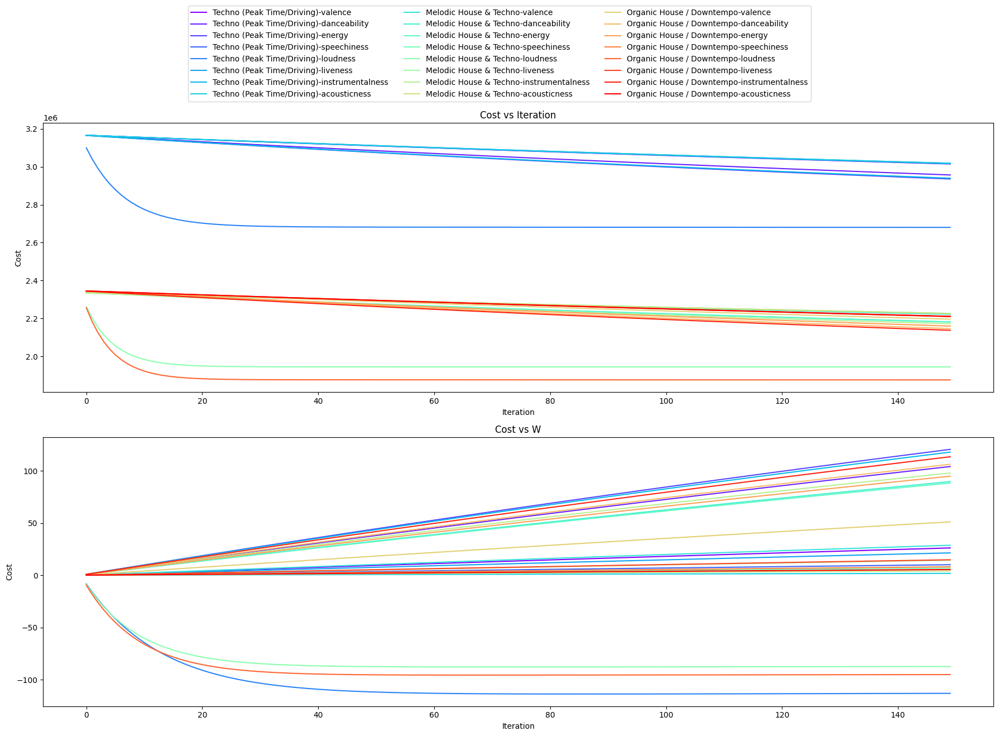

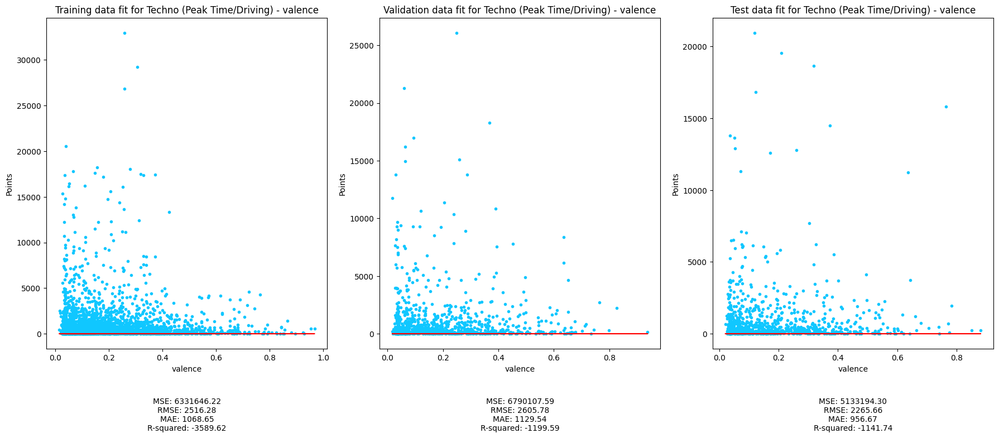

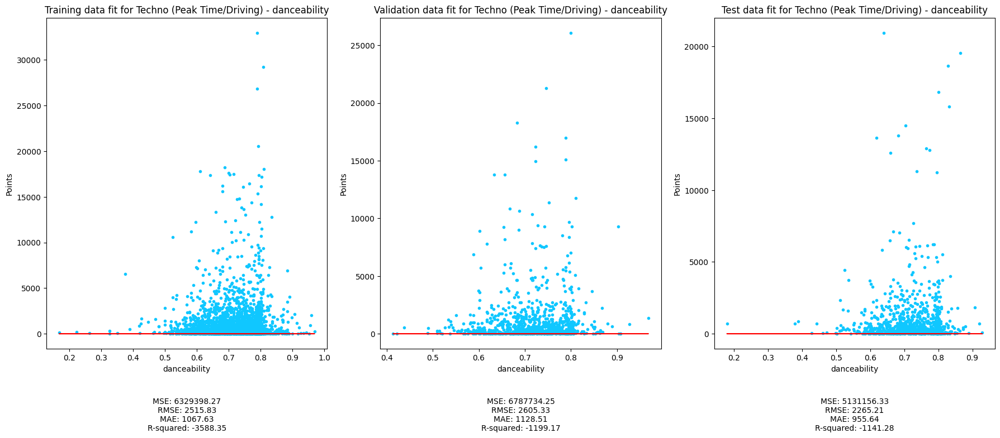

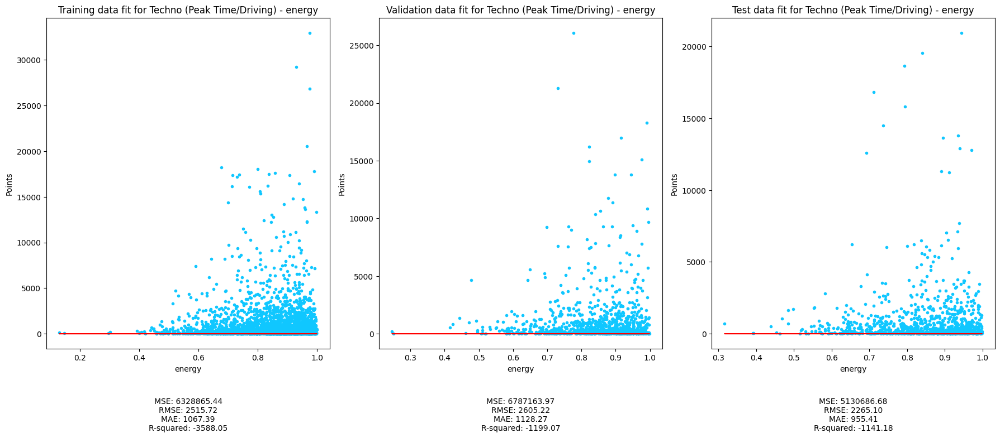

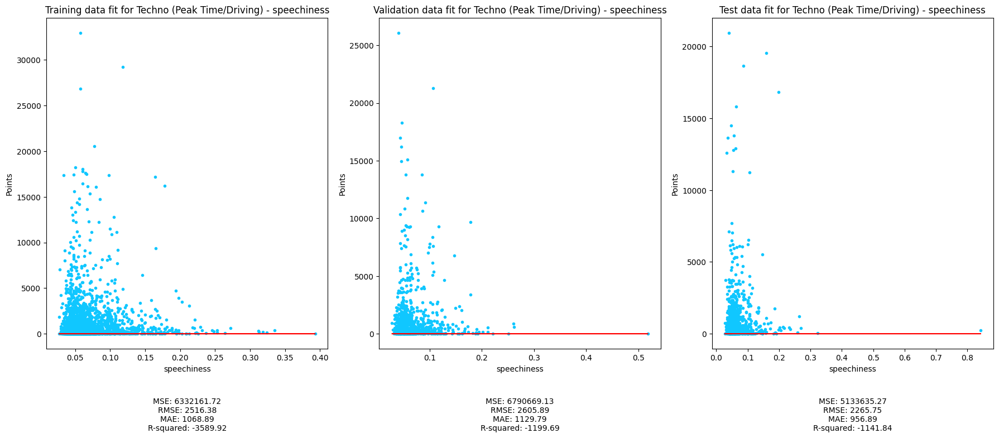

...

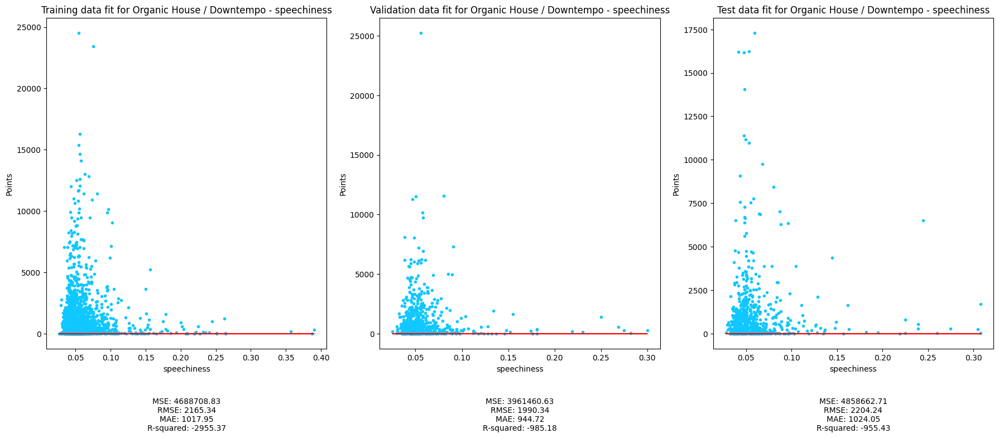

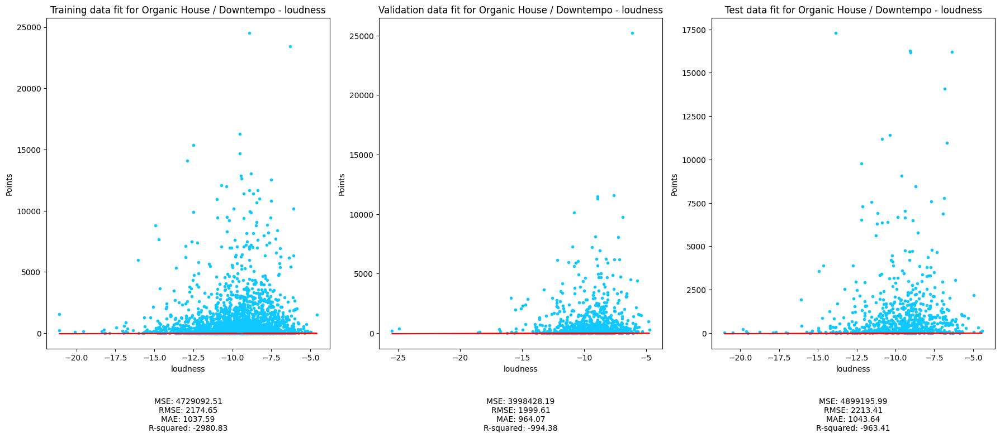

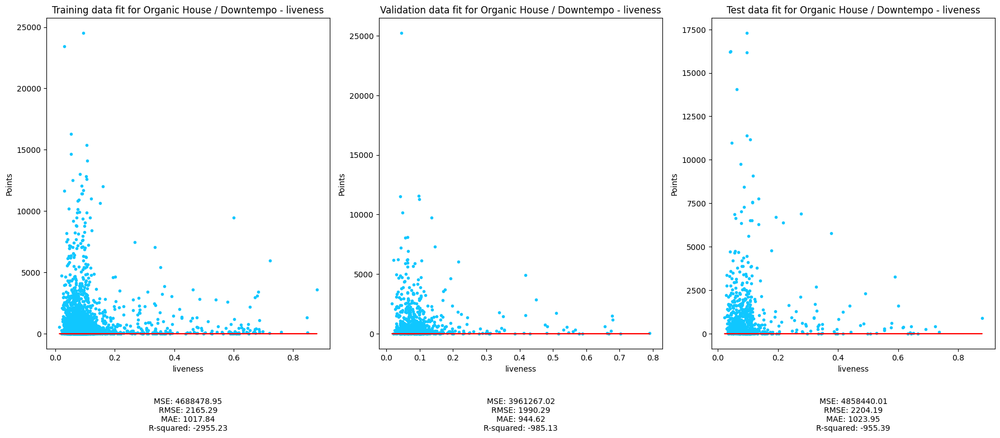

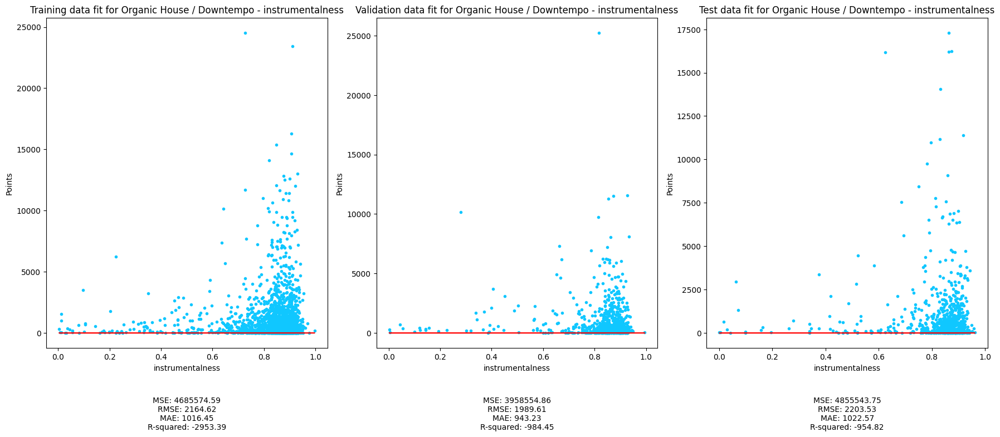

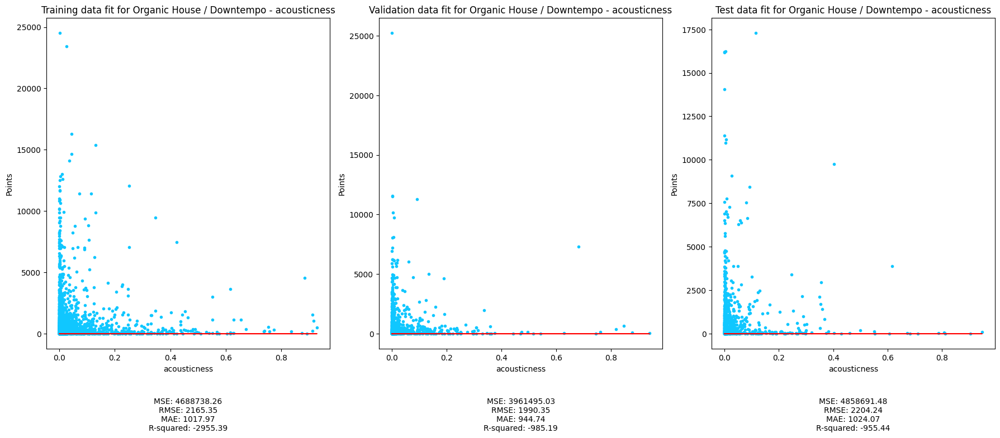

In [28]:
run_all_calculations_genre(zscore_train, zscore_validate, zscore_test)

#### Label function

Cost for Ajunadeep and valence at initial w: 2351551.590604445
Gradient at initial w & b for Ajunadeep and valence: [-351.69248189] -1063.8641975308642
Optimal w & b found by gradient descent for Ajunadeep and valence [49.01966311] 147.22930665065965
Cost for Ajunadeep and danceability at initial w: 2350766.023915347
Gradient at initial w & b for Ajunadeep and danceability: [-745.17690823] -1063.8641975308642
Optimal w & b found by gradient descent for Ajunadeep and danceability [100.89369847] 143.3626235532783
Cost for Ajunadeep and energy at initial w: 2350686.1810668726
Gradient at initial w & b for Ajunadeep and energy: [-785.21847737] -1063.8641975308642
Optimal w & b found by gradient descent for Ajunadeep and energy [105.62671275] 142.75031625069792
Cost for Ajunadeep and speechiness at initial w: 2352145.507291593
Gradient at initial w & b for Ajunadeep and speechiness: [-54.36825062] -1063.8641975308642
Optimal w & b found by gradient descent for Ajunadeep and speechiness [7.6

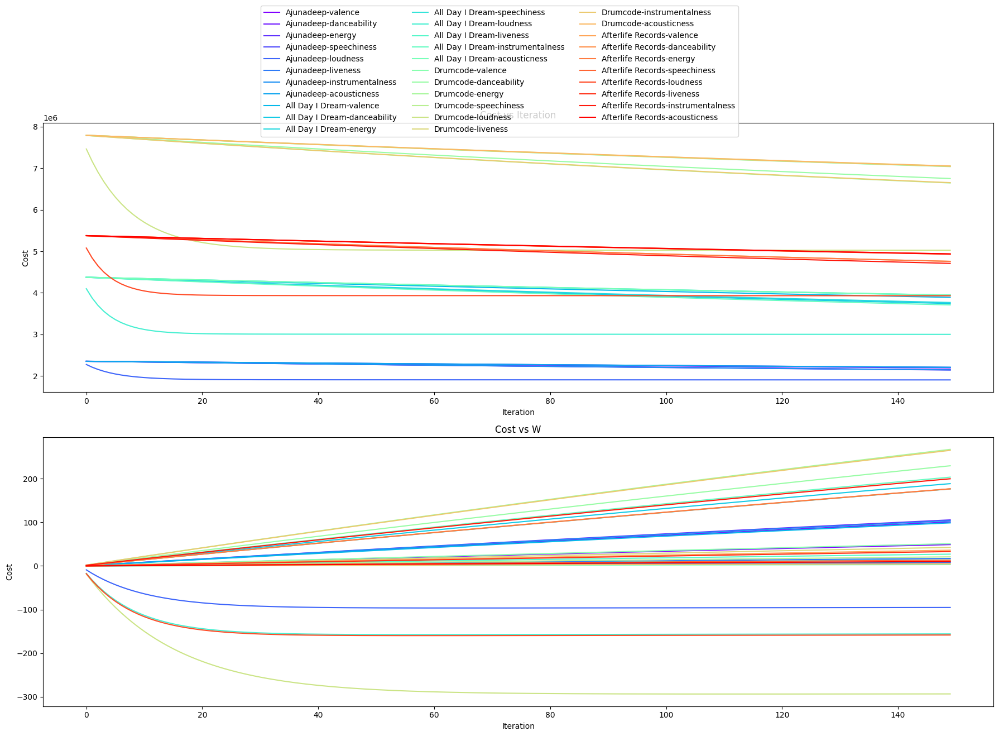

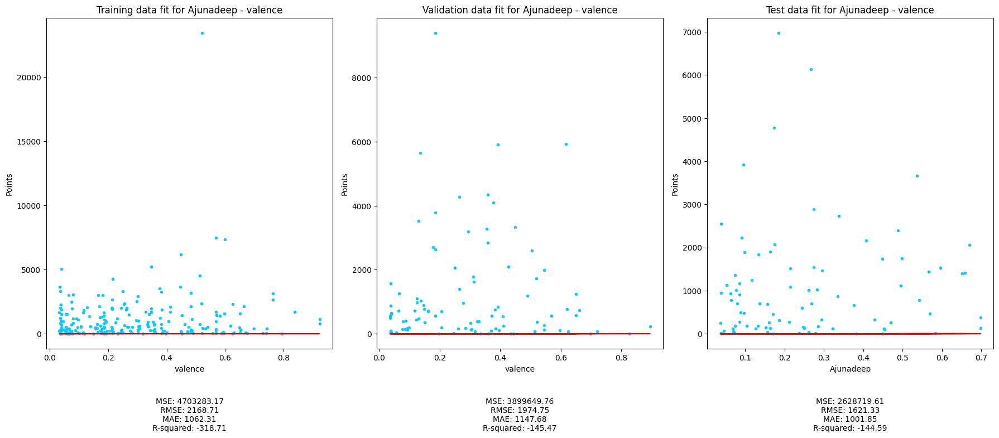

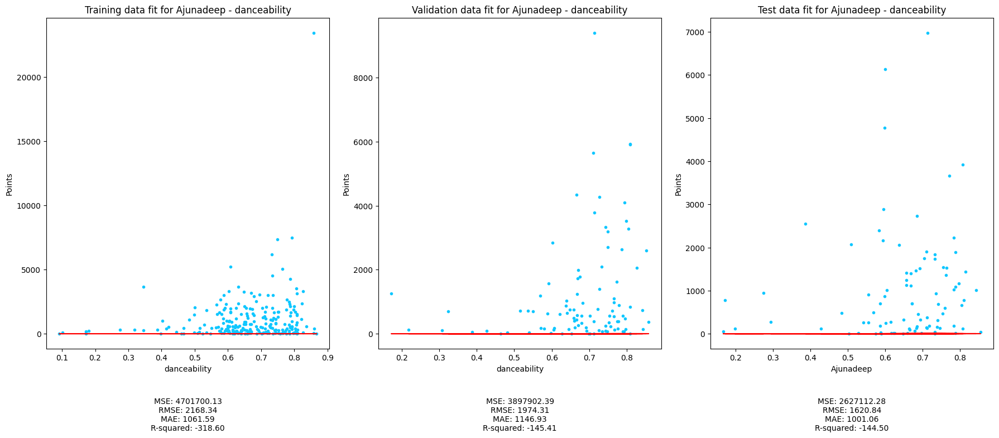

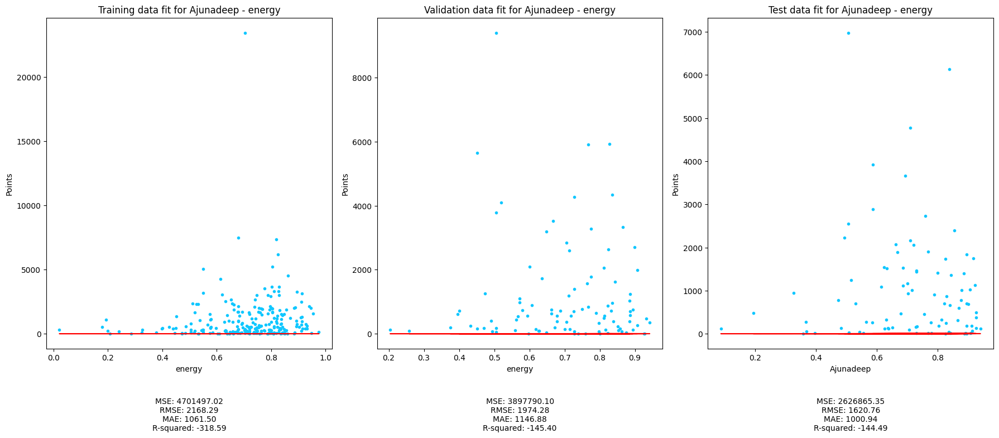

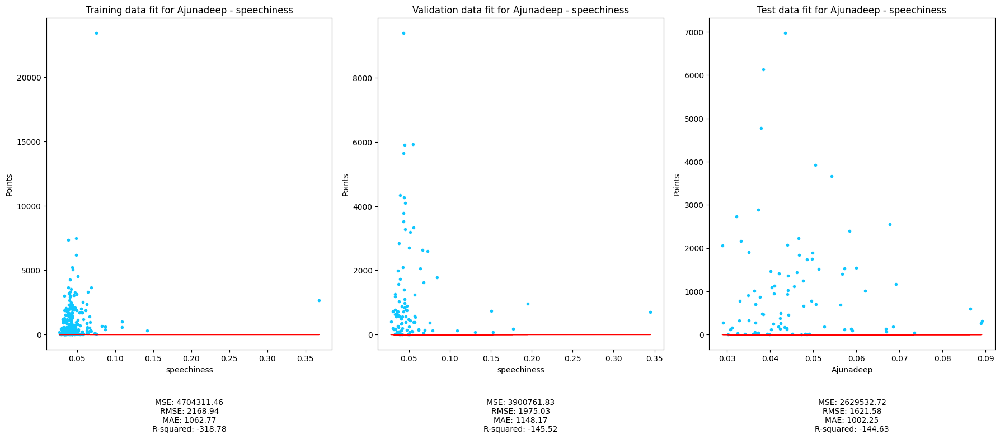

...

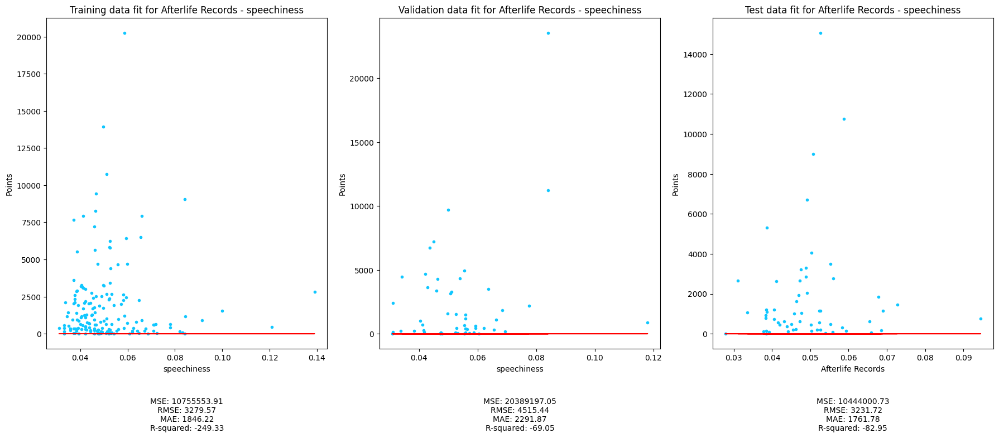

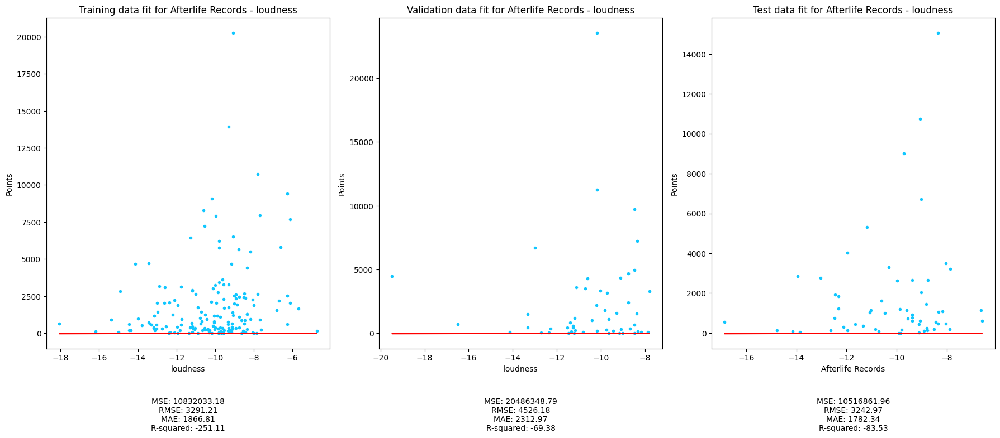

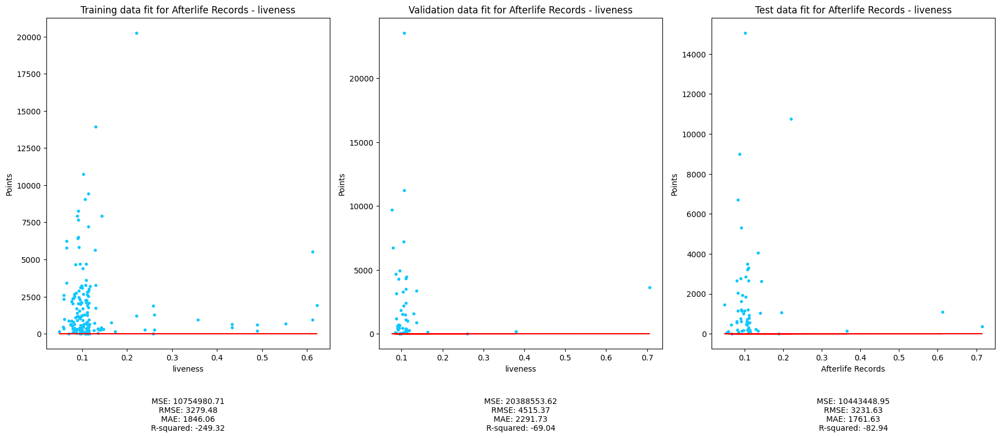

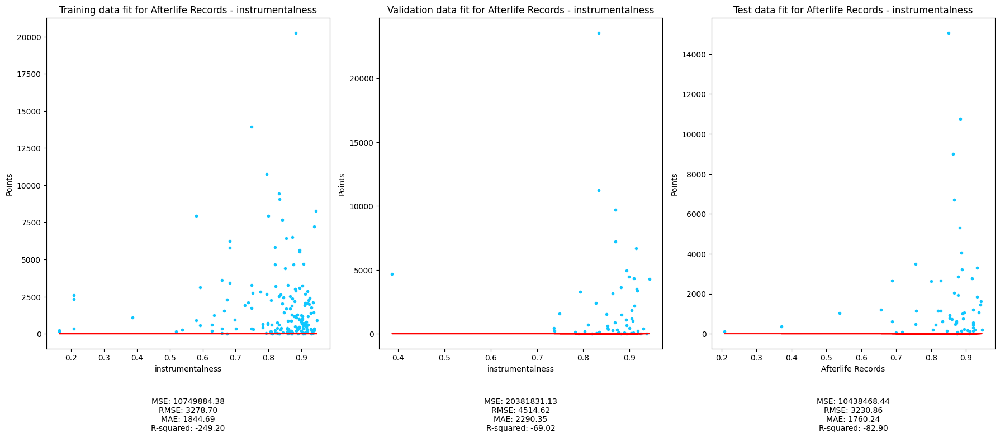

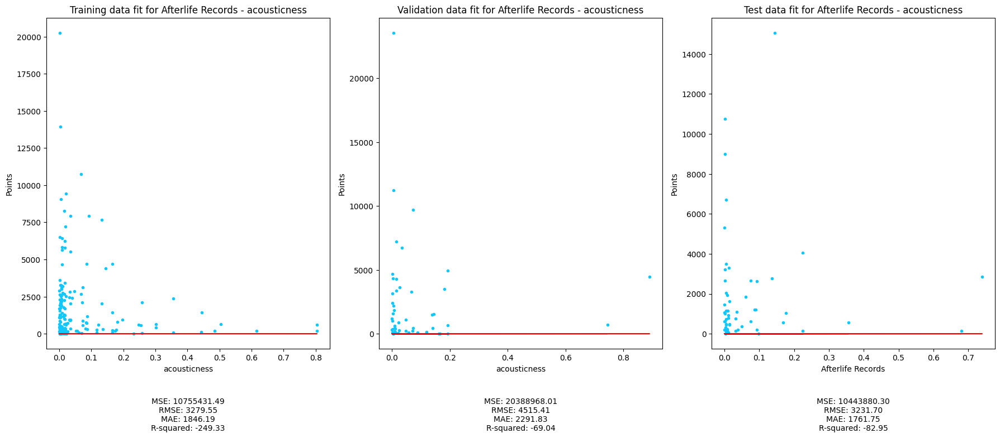

In [29]:
run_all_calculations_label(zscore_train, zscore_validate, zscore_test)

### Running mean normalized data

#### genre function

Cost for Techno (Peak Time/Driving) and valence at initial w: 3181641.6036281306
Gradient at initial w & b for Techno (Peak Time/Driving) and valence: [-200.31391919] -1070.8836893862326
Optimal w & b found by gradient descent for valence for Techno (Peak Time/Driving): [27.77834419] 148.85482410820424
Cost for Techno (Peak Time/Driving) and danceability at initial w: 3180490.655909219
Gradient at initial w & b for Techno (Peak Time/Driving) and danceability: [-776.76999525] -1070.8836893862326
Optimal w & b found by gradient descent for danceability for Techno (Peak Time/Driving): [104.39389859] 143.74504739731418
Cost for Techno (Peak Time/Driving) and energy at initial w: 3180212.4059041226
Gradient at initial w & b for Techno (Peak Time/Driving) and energy: [-916.22602102] -1070.8836893862326
Optimal w & b found by gradient descent for energy for Techno (Peak Time/Driving): [121.36379882] 141.6865913823149
Cost for Techno (Peak Time/Driving) and speechiness at initial w: 3181898.04

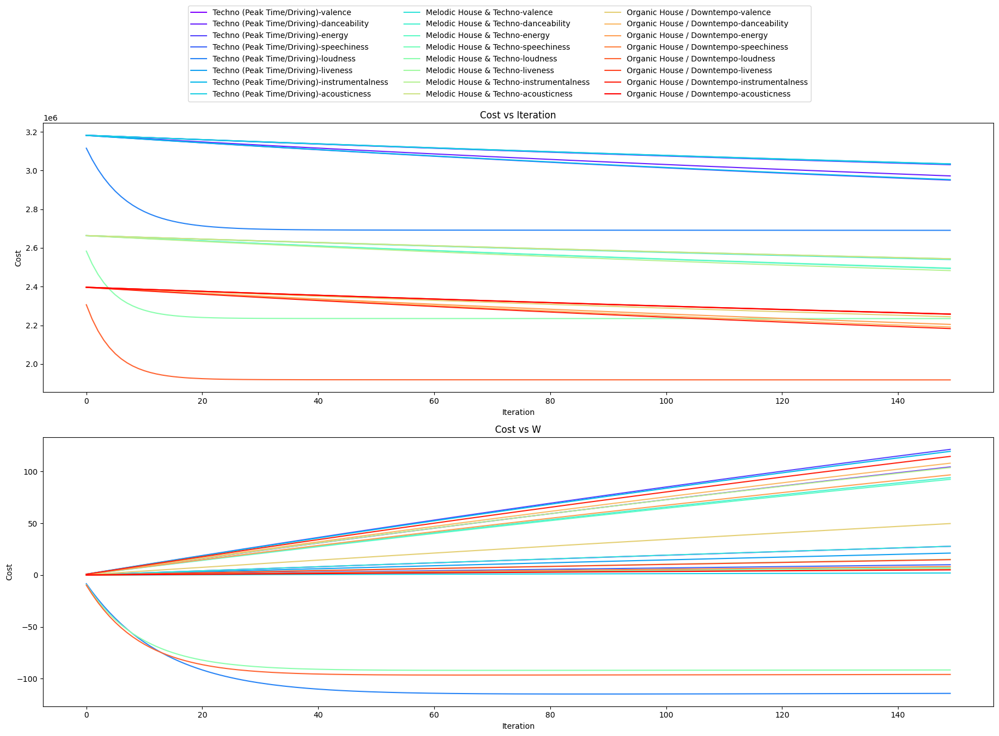

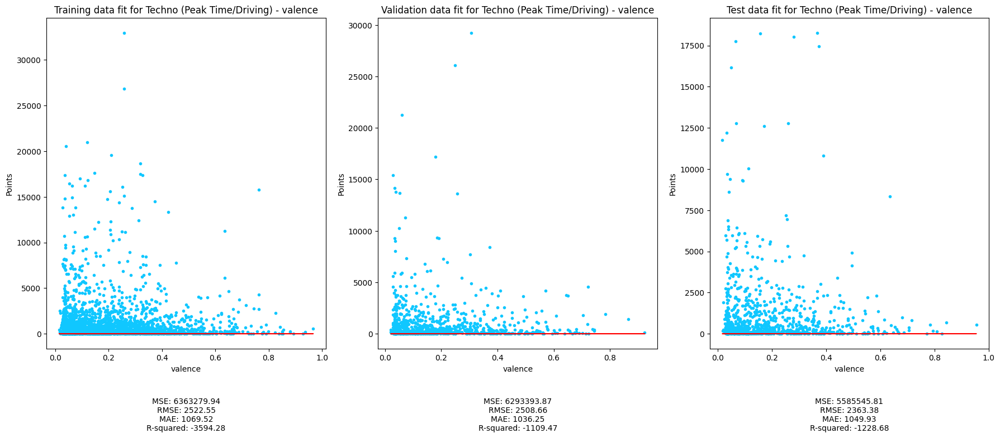

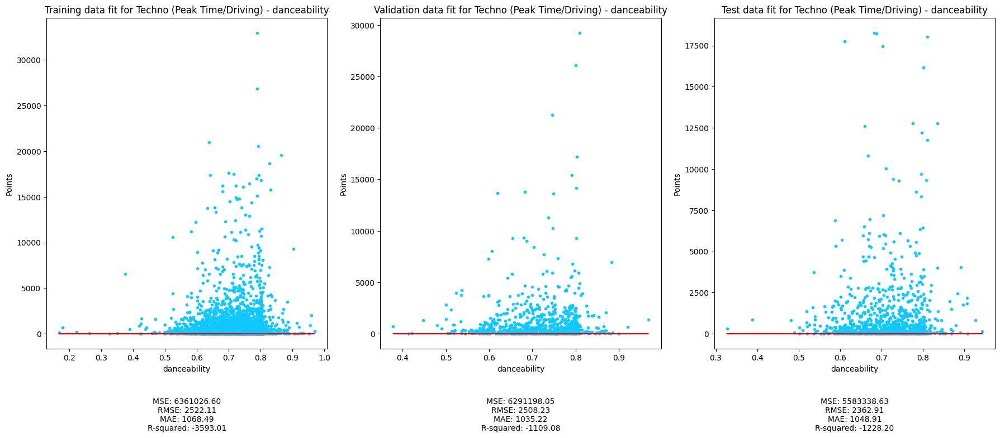

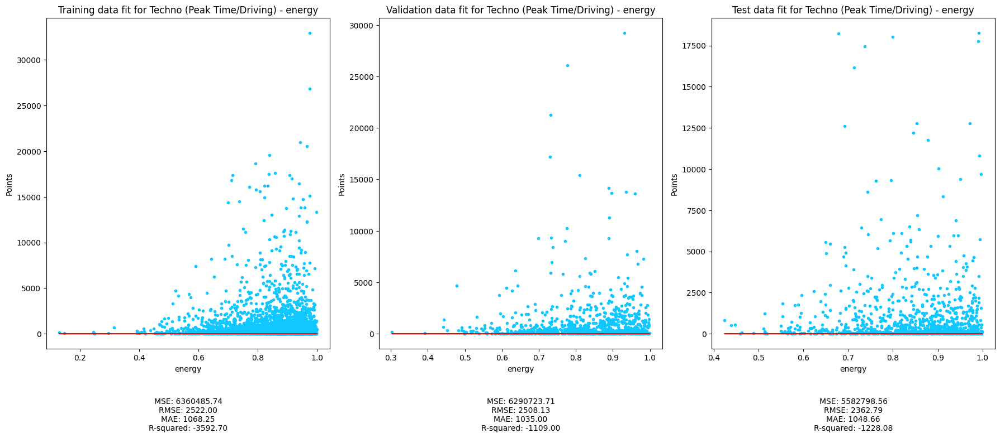

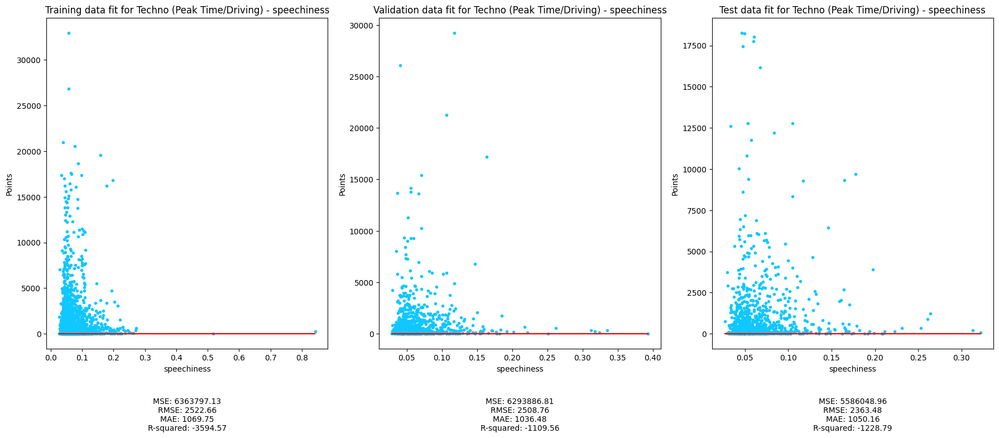

...

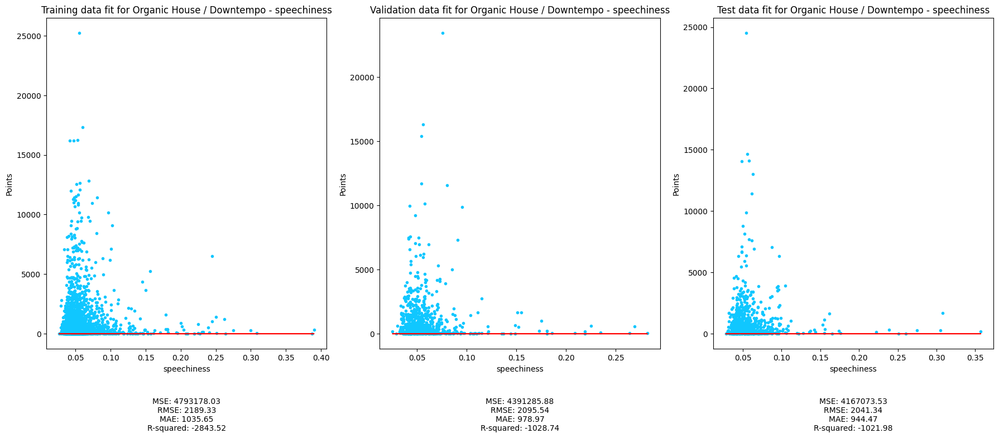

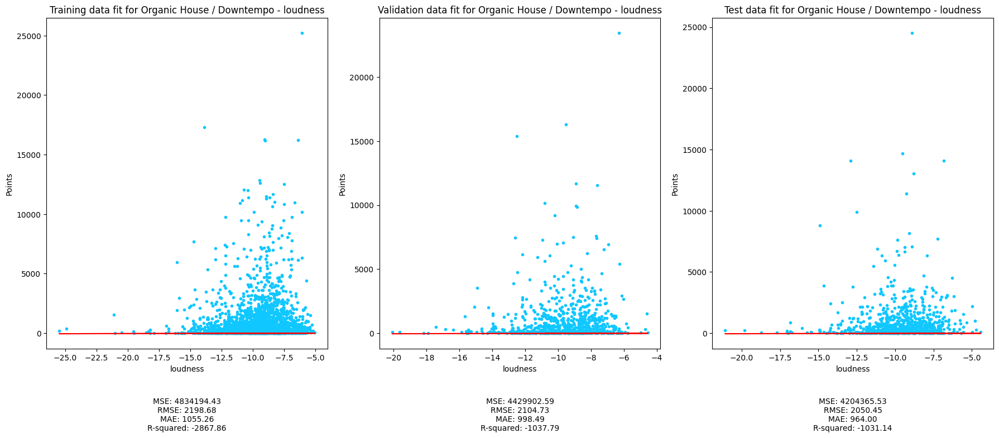

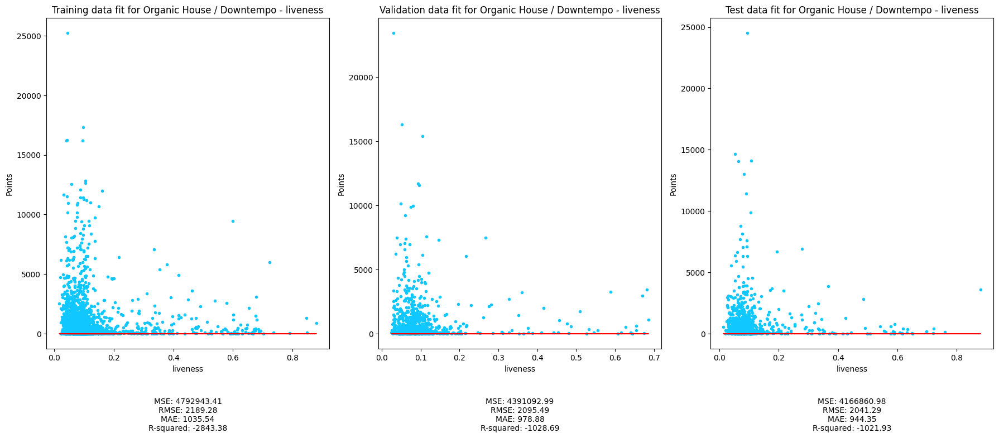

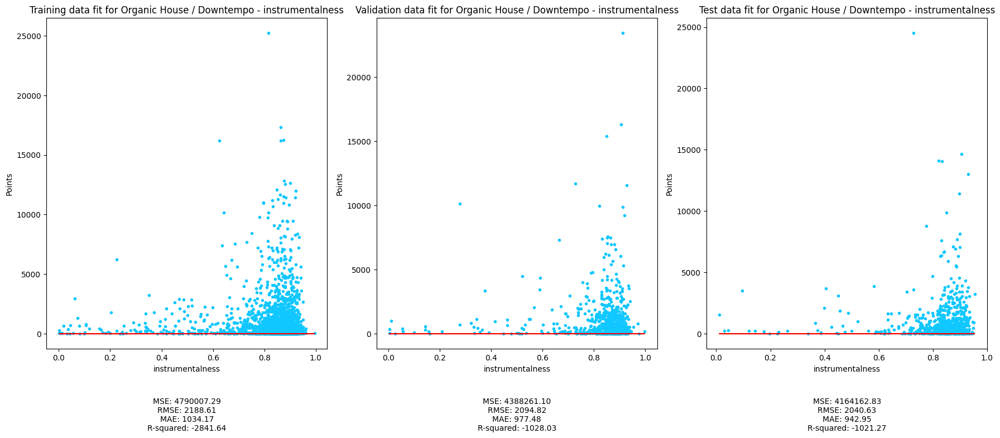

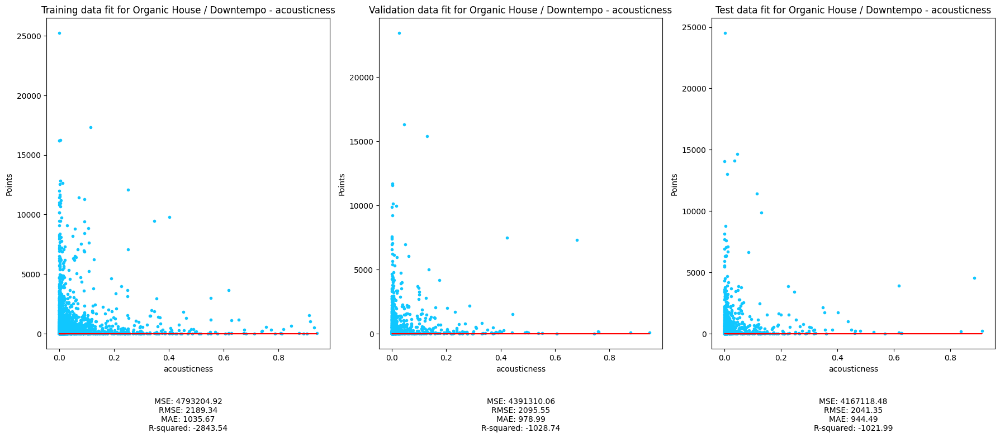

In [30]:
run_all_calculations_genre(mean_train, mean_validate, mean_test)

#### Label function

Cost for Ajunadeep and valence at initial w: 1387725.7764198936
Gradient at initial w & b for Ajunadeep and valence: [-332.24867439] -1020.0853658536586
Optimal w & b found by gradient descent for Ajunadeep and valence [46.2226802] 141.17484068347292
Cost for Ajunadeep and danceability at initial w: 1386946.6113316827
Gradient at initial w & b for Ajunadeep and danceability: [-722.56154065] -1020.0853658536586
Optimal w & b found by gradient descent for Ajunadeep and danceability [97.61635423] 137.3013419002556
Cost for Ajunadeep and energy at initial w: 1386889.5282626583
Gradient at initial w & b for Ajunadeep and energy: [-751.1902561] -1020.0853658536586
Optimal w & b found by gradient descent for Ajunadeep and energy [101.02489703] 136.88770465501406
Cost for Ajunadeep and speechiness at initial w: 1388286.362969076
Gradient at initial w & b for Ajunadeep and speechiness: [-51.5882378] -1020.0853658536586
Optimal w & b found by gradient descent for Ajunadeep and speechiness [7.203

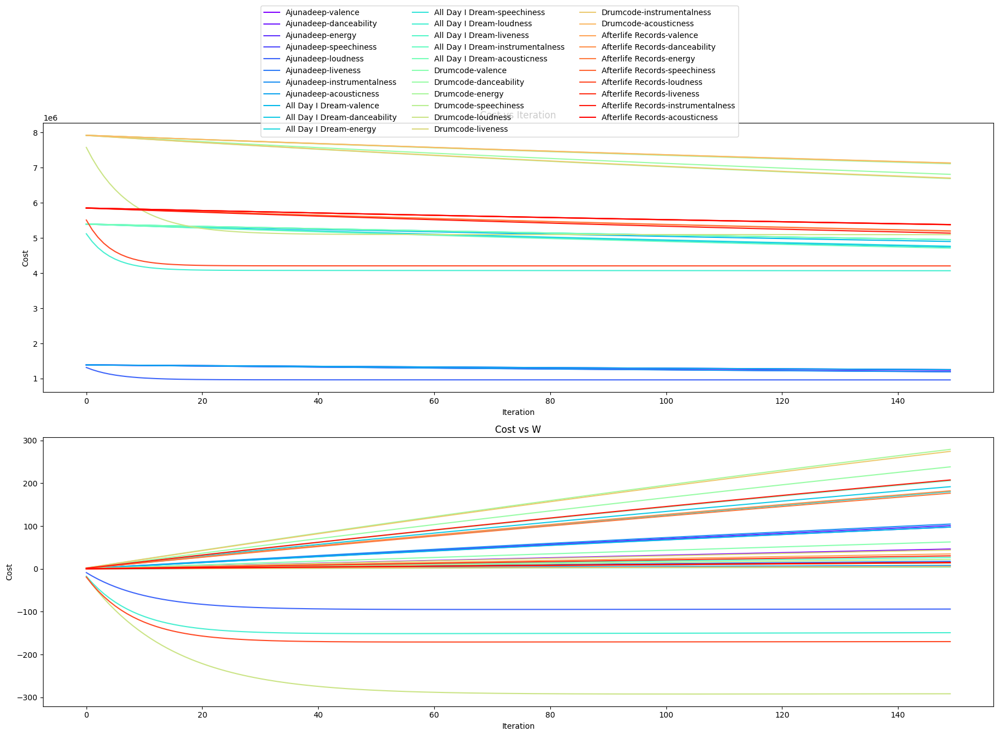

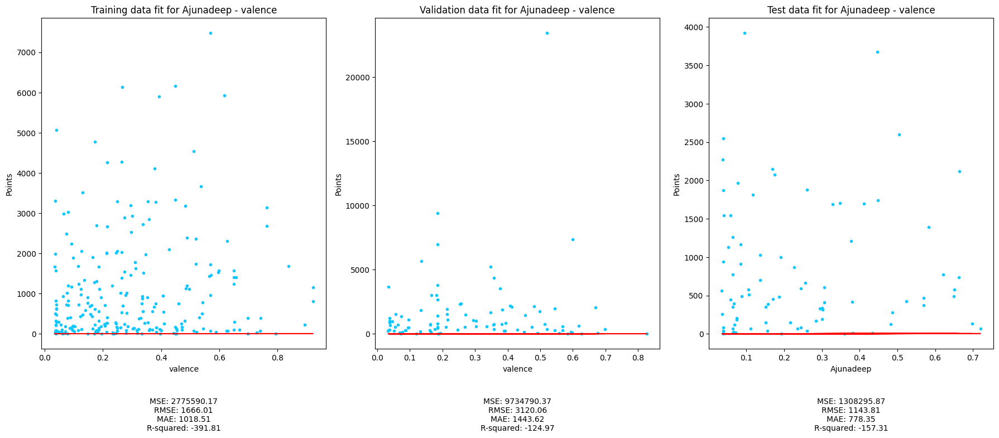

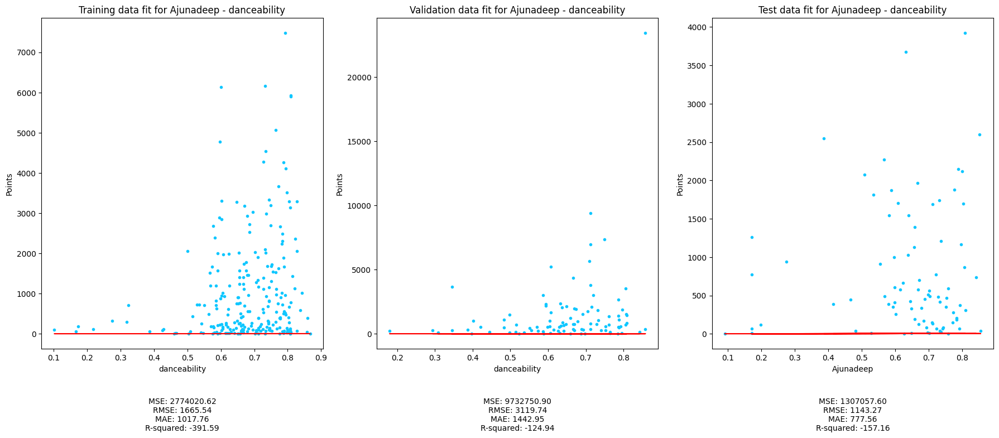

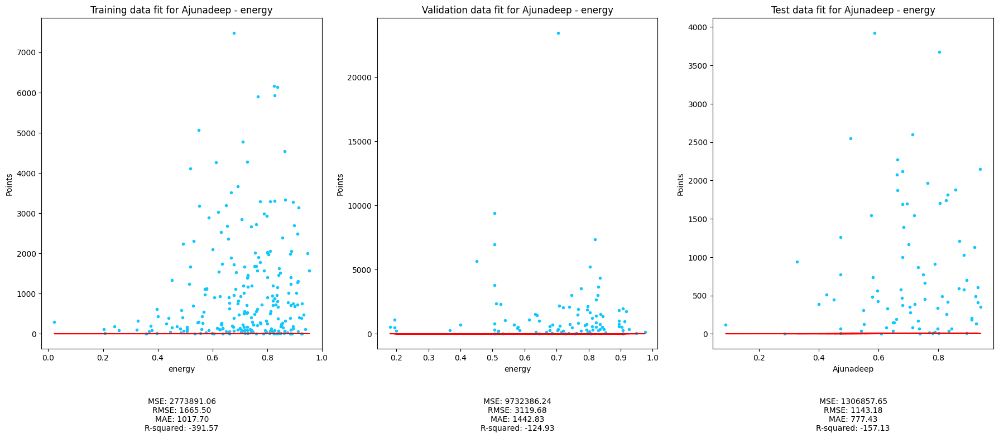

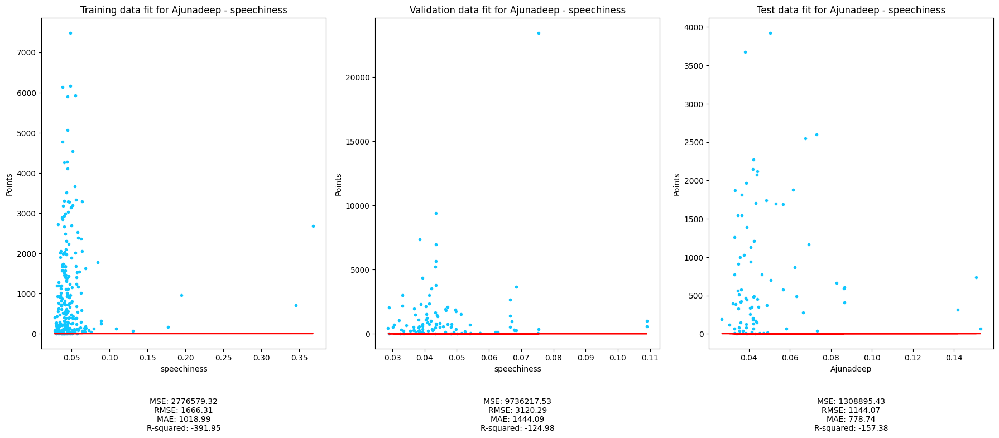

...

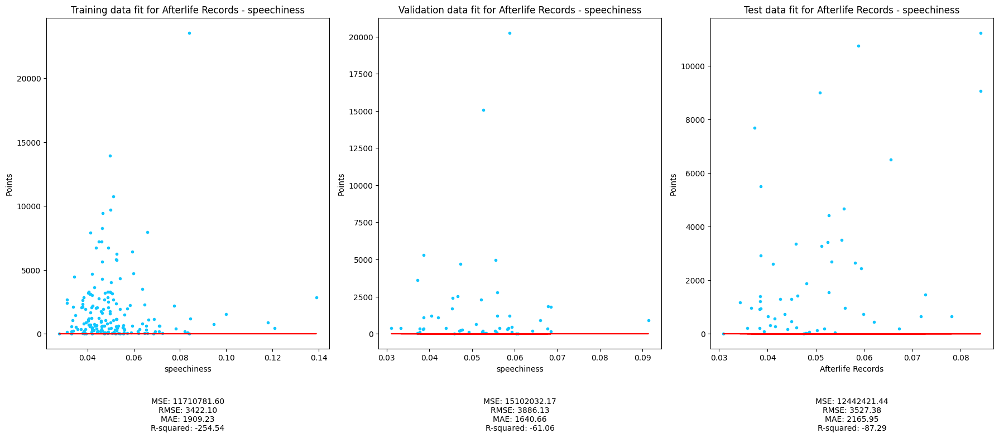

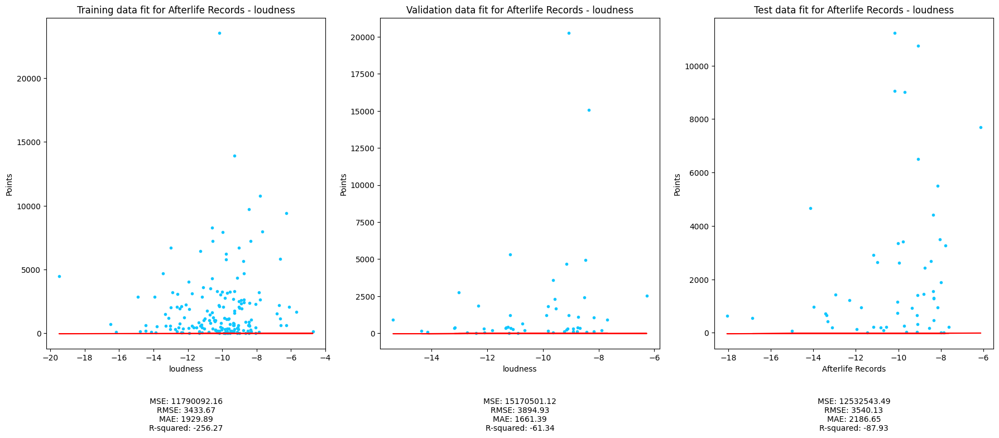

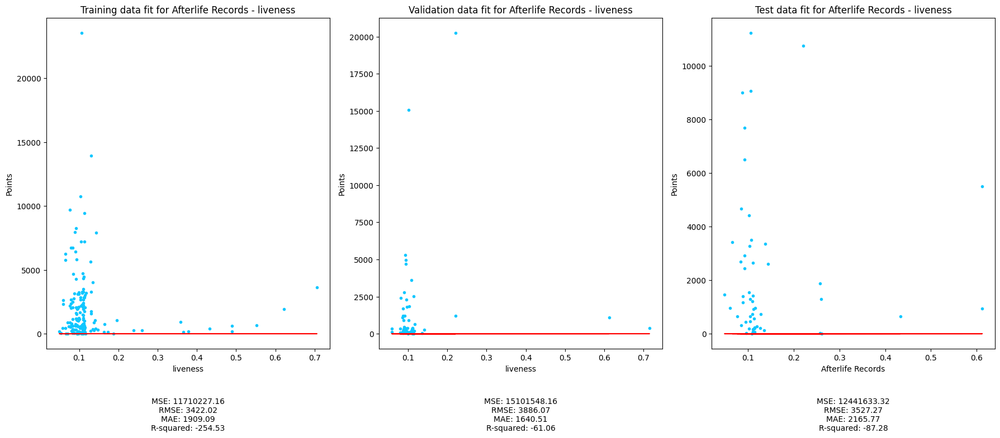

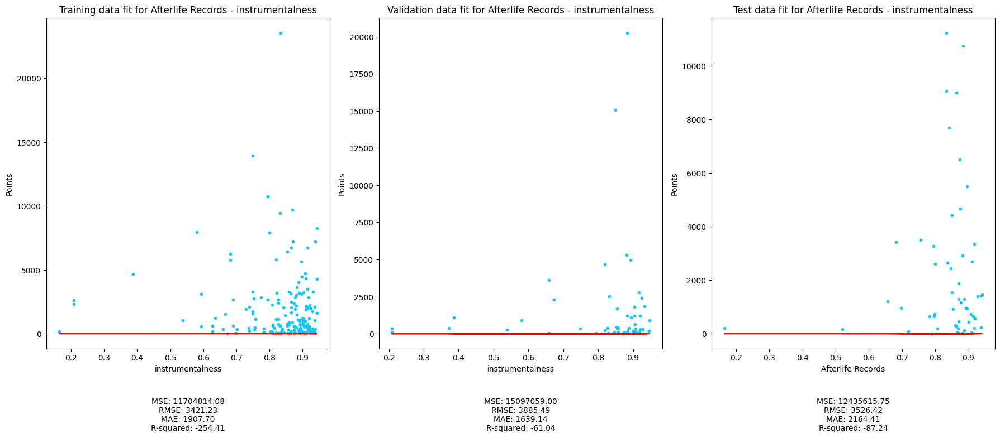

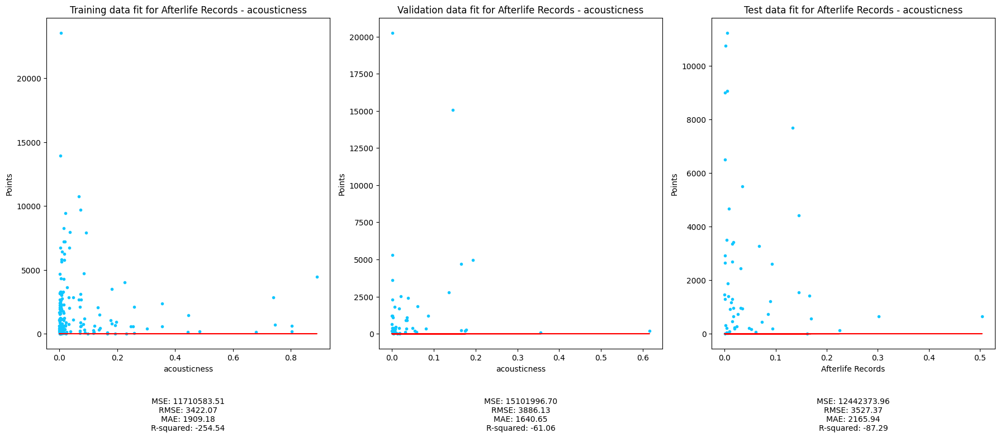

In [31]:
run_all_calculations_label(mean_train, mean_validate, mean_test)

### Running log normalized data

#### Genre function

Cost for Techno (Peak Time/Driving) and valence at initial w: 2756182.561454402
Gradient at initial w & b for Techno (Peak Time/Driving) and valence: [-186.38003769] -1035.4833504977687
Optimal w & b found by gradient descent for valence for Techno (Peak Time/Driving): [25.7572645] 143.94703318586474
Cost for Techno (Peak Time/Driving) and danceability at initial w: 2755060.468024341
Gradient at initial w & b for Techno (Peak Time/Driving) and danceability: [-748.40639341] -1035.4833504977687
Optimal w & b found by gradient descent for danceability for Techno (Peak Time/Driving): [100.56557556] 139.01647516185307
Cost for Techno (Peak Time/Driving) and energy at initial w: 2754789.101233084
Gradient at initial w & b for Techno (Peak Time/Driving) and energy: [-884.41745108] -1035.4833504977687
Optimal w & b found by gradient descent for energy for Techno (Peak Time/Driving): [117.17798244] 137.03003585766362
Cost for Techno (Peak Time/Driving) and speechiness at initial w: 2756417.5919

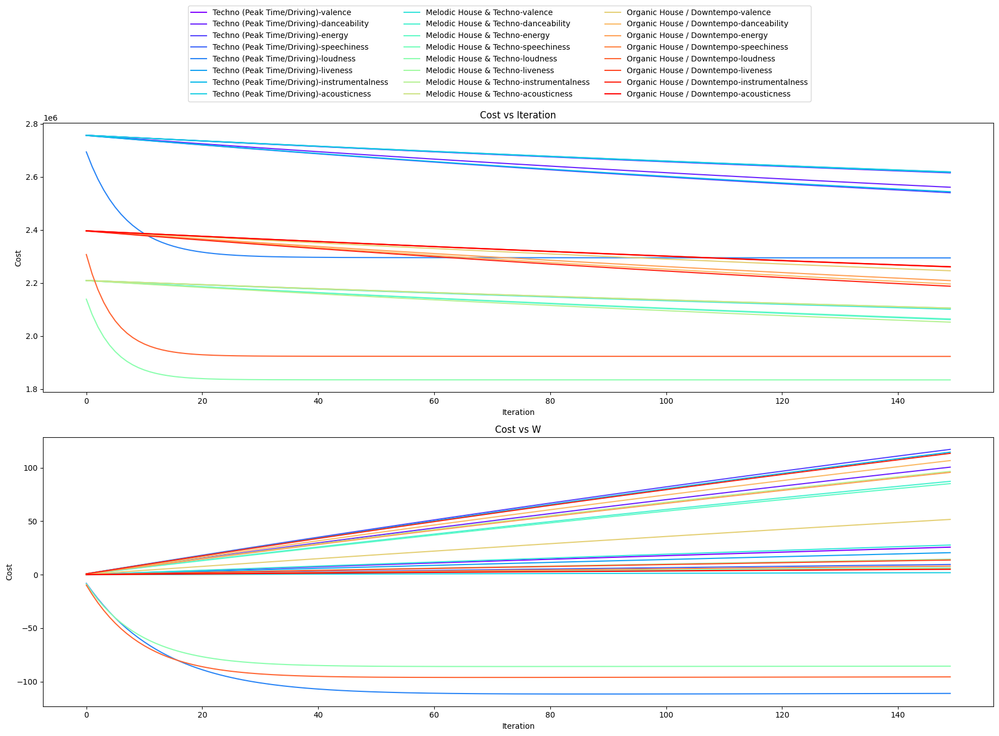

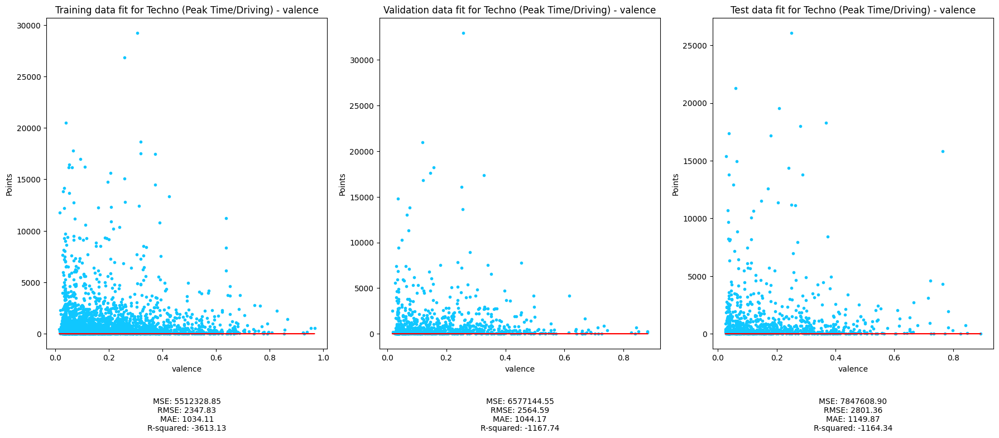

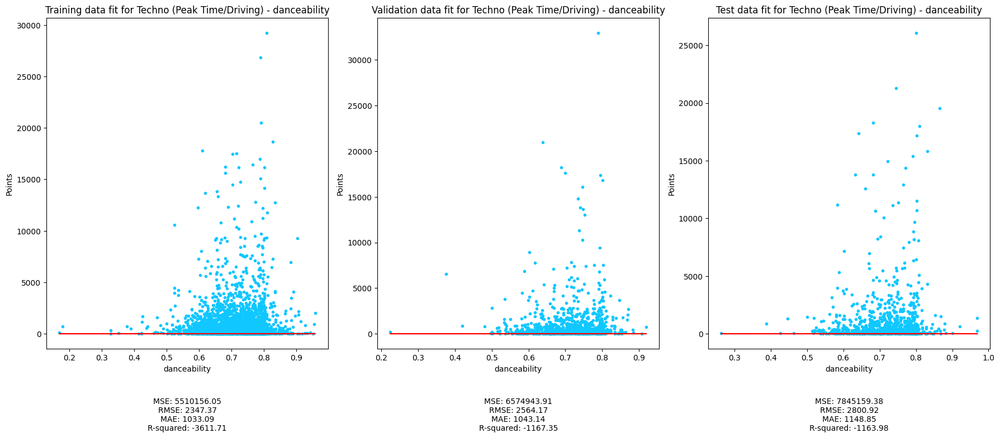

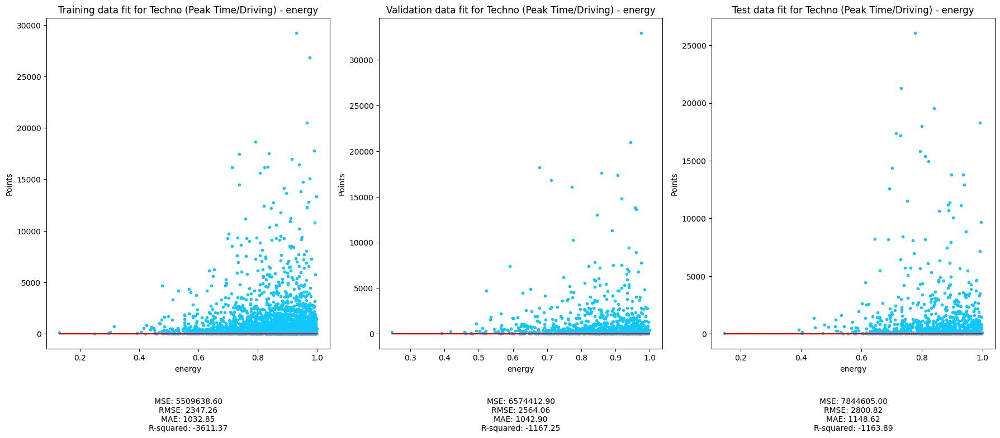

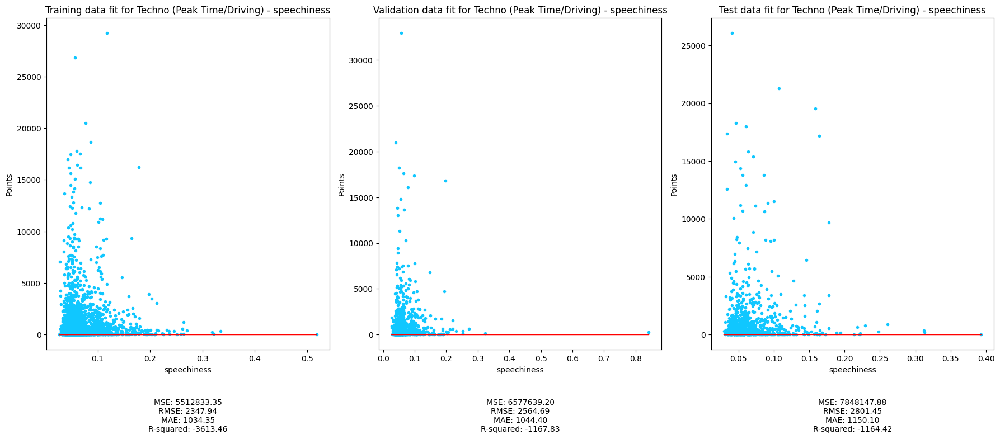

...

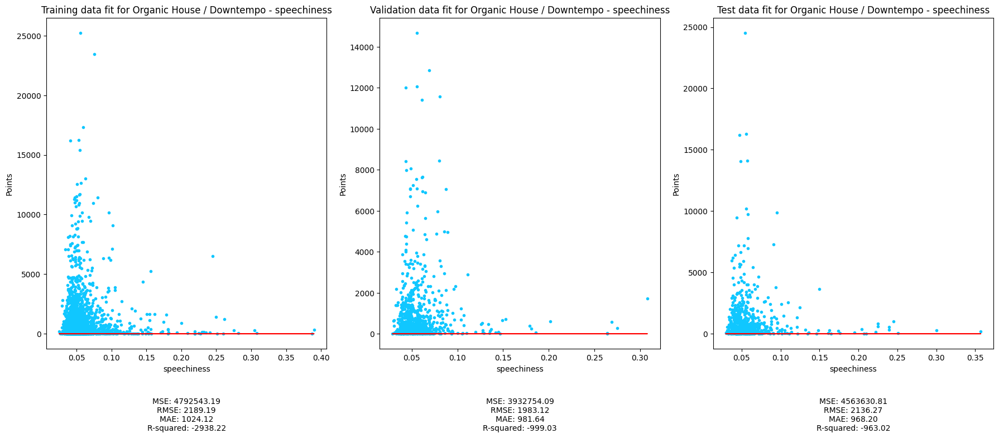

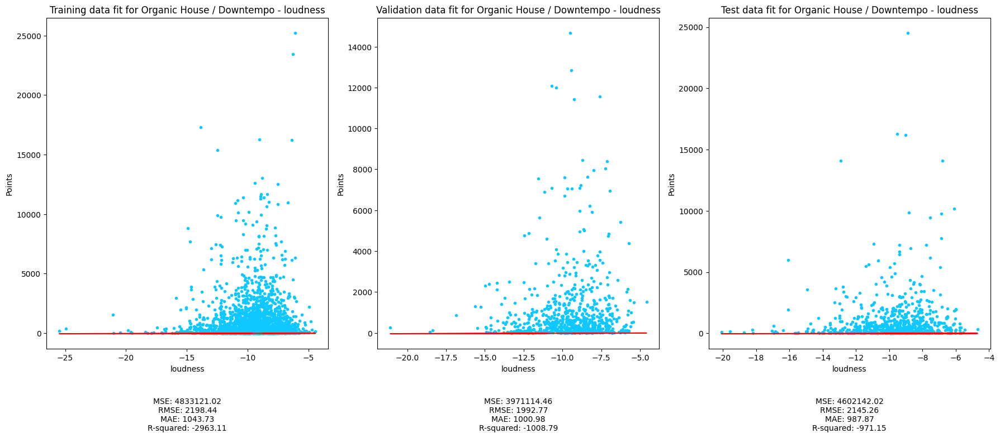

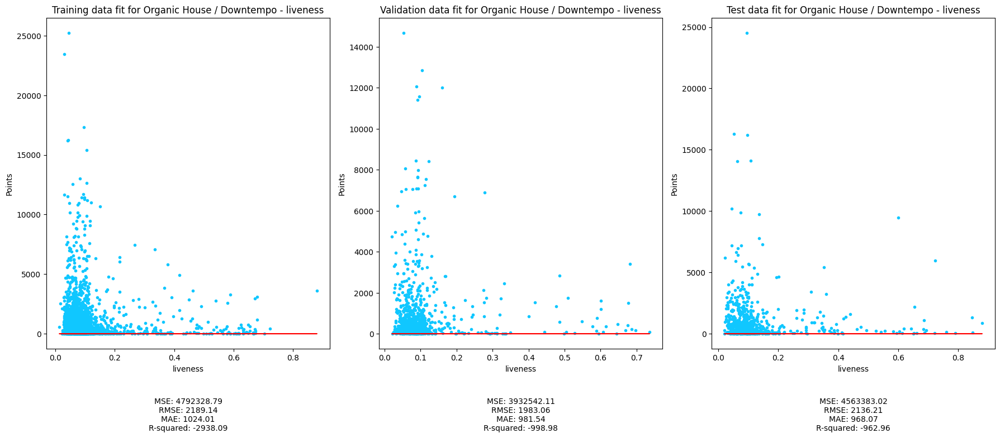

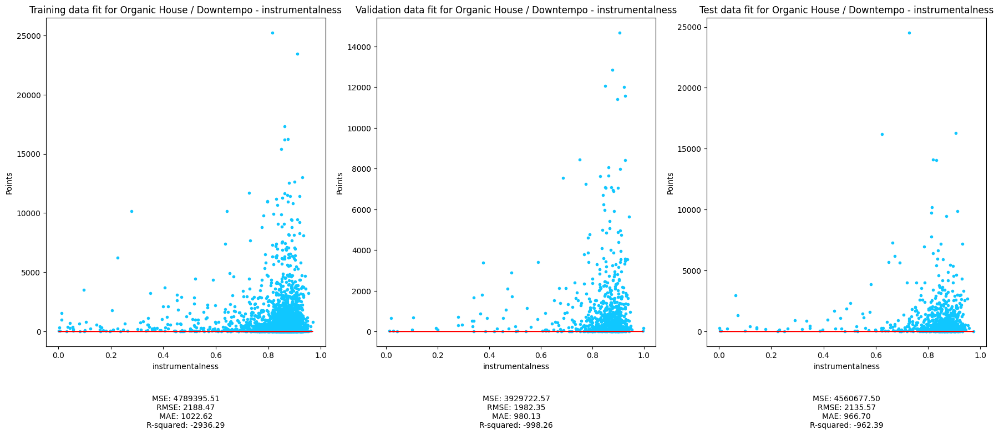

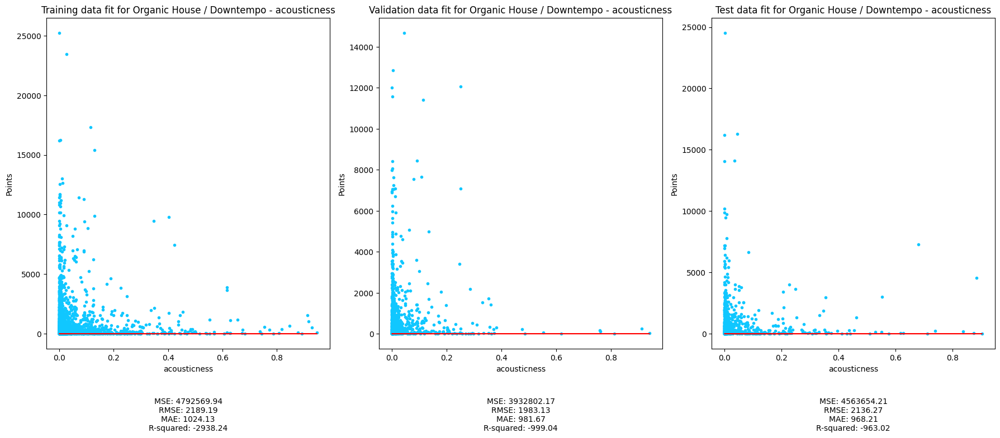

In [32]:
run_all_calculations_genre(log_train, log_validate, log_test)

#### Label function

Cost for Ajunadeep and valence at initial w: 2482291.6808831836
Gradient at initial w & b for Ajunadeep and valence: [-352.66906721] -1150.2024291497976
Optimal w & b found by gradient descent for Ajunadeep and valence [49.00105851] 159.28617218380964
Cost for Ajunadeep and danceability at initial w: 2481404.08909744
Gradient at initial w & b for Ajunadeep and danceability: [-797.15543198] -1150.2024291497976
Optimal w & b found by gradient descent for Ajunadeep and danceability [108.05625785] 155.1353003301318
Cost for Ajunadeep and energy at initial w: 2481381.2213108004
Gradient at initial w & b for Ajunadeep and energy: [-808.69391174] -1150.2024291497976
Optimal w & b found by gradient descent for Ajunadeep and energy [108.74183882] 154.76336978533809
Cost for Ajunadeep and speechiness at initial w: 2482876.6673188126
Gradient at initial w & b for Ajunadeep and speechiness: [-59.82435304] -1150.2024291497976
Optimal w & b found by gradient descent for Ajunadeep and speechiness [8.

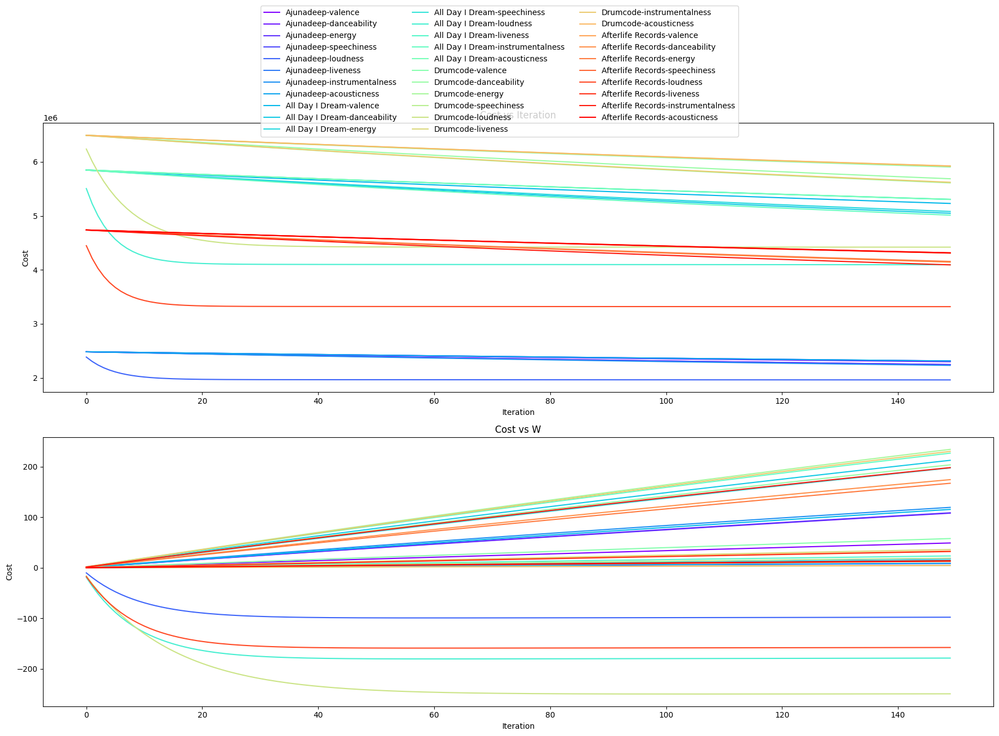

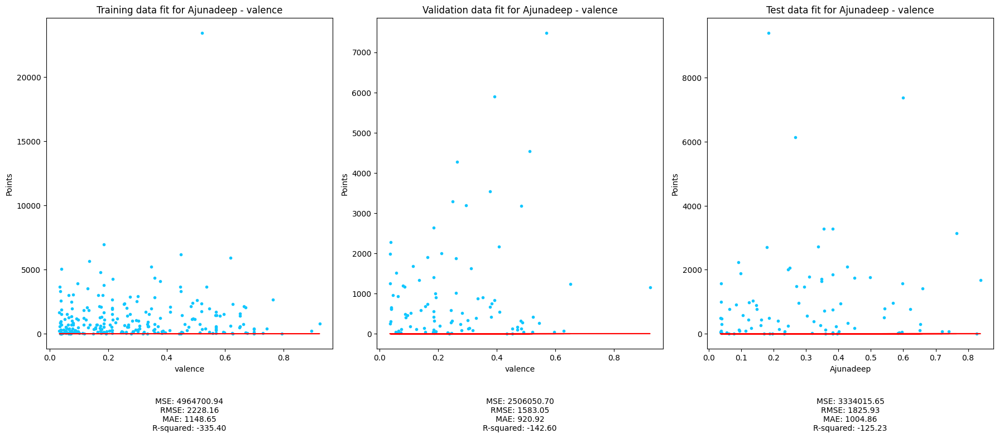

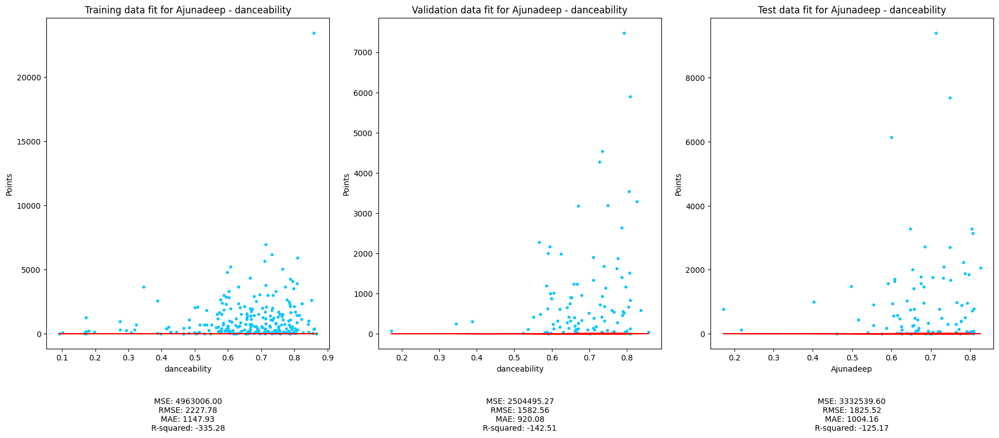

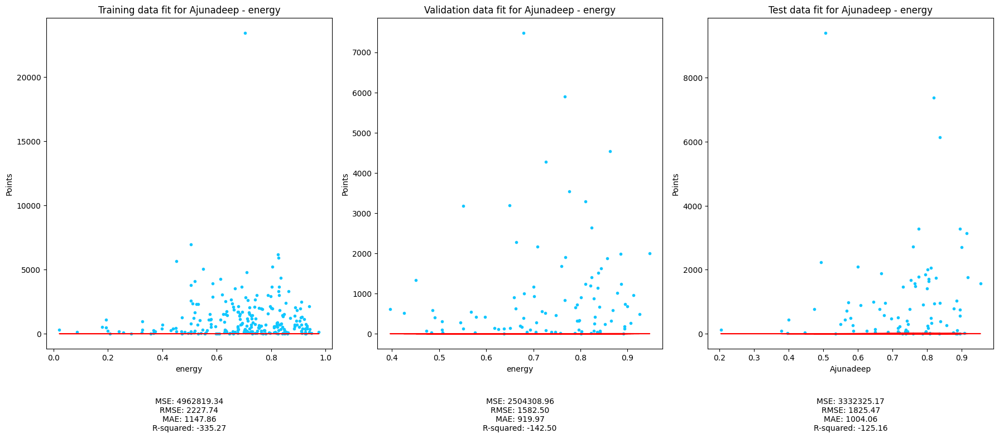

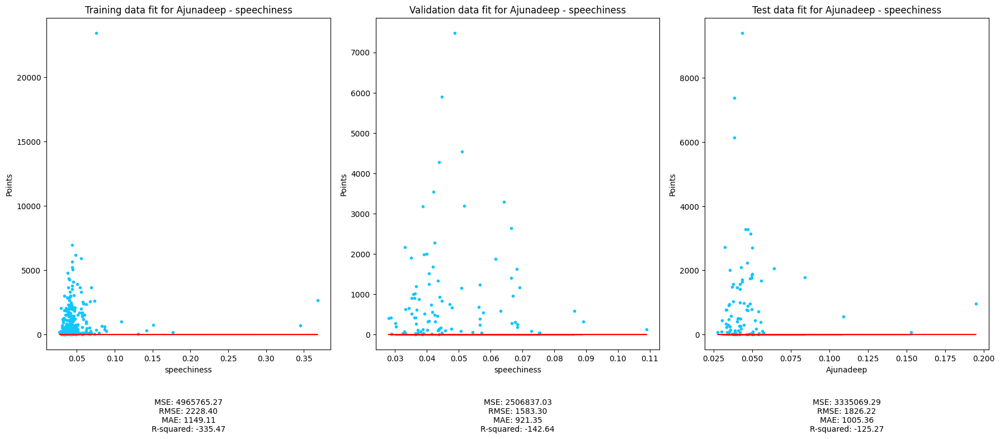

...

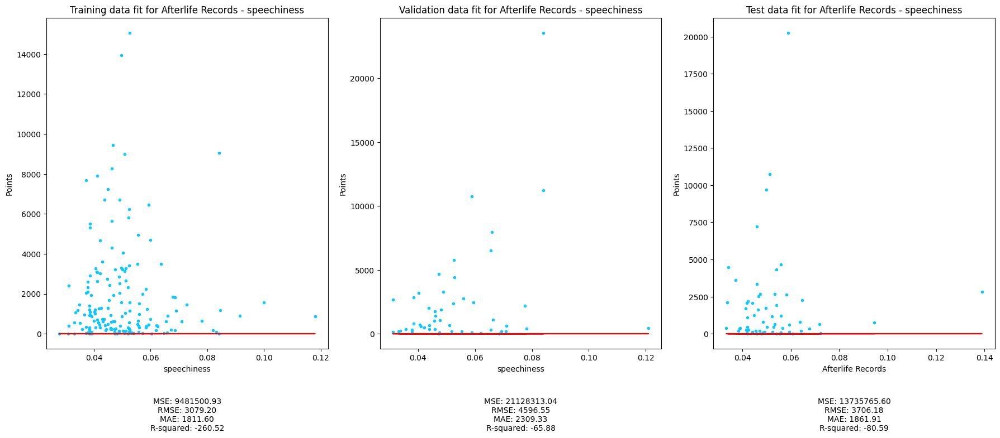

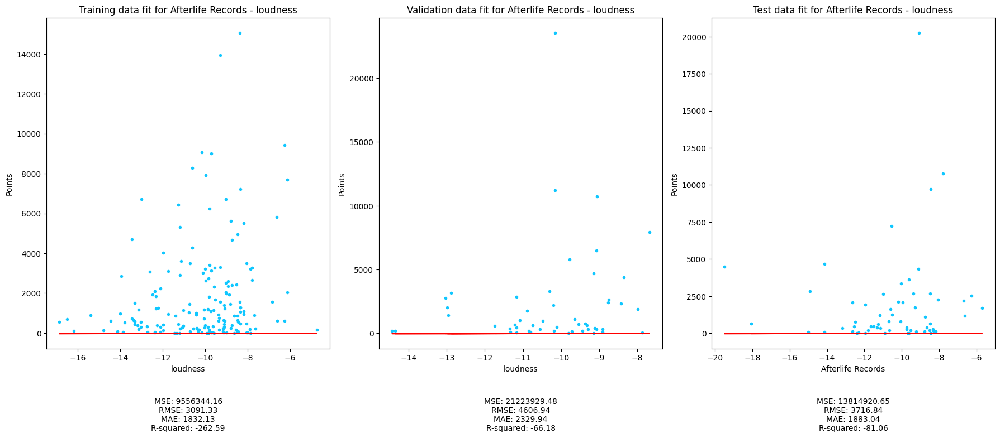

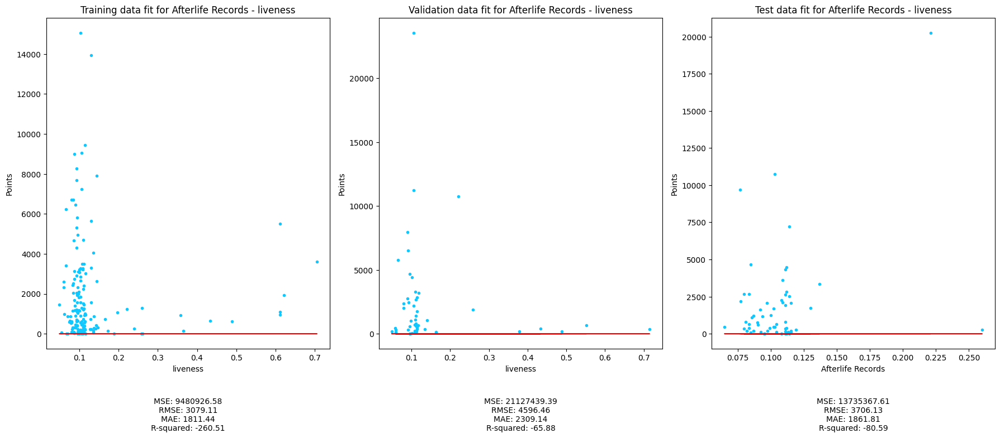

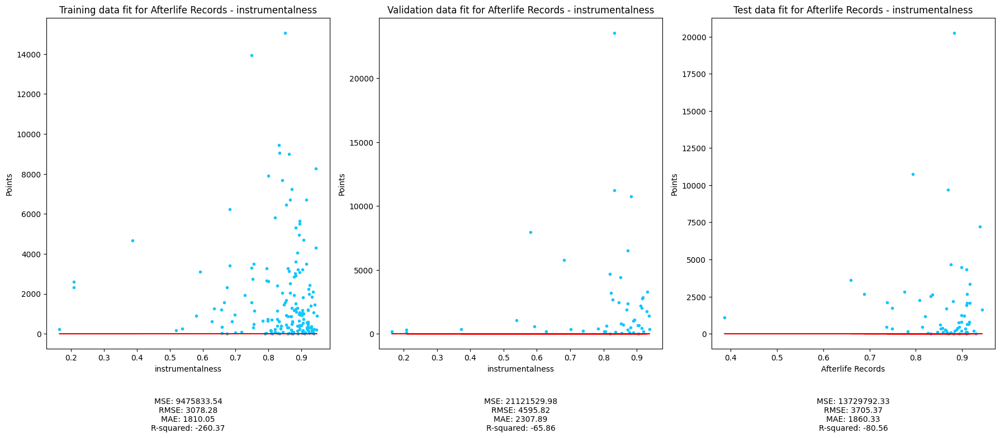

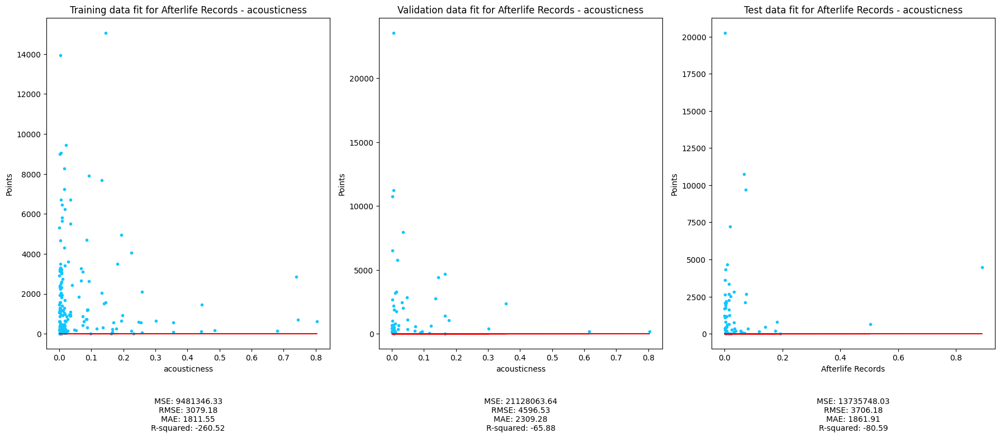

In [33]:
run_all_calculations_label(log_train, log_validate, log_test)